# Librerias e importaciones

In [1]:
%pip install es_core_news_sm
%pip install -U spacy
%pip install Scikit-learn
%pip install ydata_profiling
%pip install seaborn
%pip install ydata_profiling
%pip install matplotlib
%pip install --upgrade pip
%pip install nltk
%pip install langdetect

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
!python -m spacy download es_core_news_sm
import pandas as pd
import numpy as np
import nltk
import spacy
import string
import seaborn as sns
import matplotlib.pyplot as plt
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('words')
nltk.download('snowball_data')
nltk.download('wordnet')
nltk.download('omw')
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from langdetect import detect
from spacy.lang.es.examples import sentences
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

from imblearn.over_sampling import SMOTE
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix, classification_report, precision_score, recall_score, f1_score, accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

from matplotlib import style
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
import sklearn
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
from sklearn.model_selection import RepeatedKFold
from sklearn.preprocessing import RobustScaler
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

     ---------------------------------------- 0.0/12.9 MB ? eta -:--:--
     - -------------------------------------- 0.5/12.9 MB 9.8 MB/s eta 0:00:02
     ---- ----------------------------------- 1.4/12.9 MB 14.6 MB/s eta 0:00:01
     ------- -------------------------------- 2.4/12.9 MB 17.0 MB/s eta 0:00:01
     ----------- ---------------------------- 3.8/12.9 MB 20.2 MB/s eta 0:00:01
     ---------------- ----------------------- 5.2/12.9 MB 24.0 MB/s eta 0:00:01
     ------------------- -------------------- 6.3/12.9 MB 25.1 MB/s eta 0:00:01
     ------------------------ --------------- 7.8/12.9 MB 24.8 MB/s eta 0:00:01
     ----------------------------- ---------- 9.6/12.9 MB 26.6 MB/s eta 0:00:01
     ---------------------------------- ---- 11.3/12.9 MB 31.2 MB/s eta 0:00:01
     --------------------------------------  12.9/12.9 MB 32.7 MB/s eta 0:00:01
     --------------------------------------- 12.9/12.9 MB 31.2 MB/s eta 0:00:00
✔ Download and installation successful
You can no

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!
[nltk_data] Downloading package snowball_data to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package snowball_data is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package omw is already up-to-date!


# Carga y preprocesamiento básico de datos

In [3]:
df = pd.read_csv('Datos.csv', sep=',', encoding = 'utf-8')
data = df.copy()

In [4]:
data.head()

,Review,Class
0,Nos alojamos en una casa alquilada en la ciuda...,4
1,"La comida está bien, pero nada especial. Yo te...",3
2,"En mi opinión, no es una como muchos usuarios ...",3
3,esta curiosa forma que asemeja una silla de mo...,4
4,Lo mejor era la limonada. Me gusto la comida d...,2


##Preparación y verificación basica de los datos

In [5]:
data.shape

(7875, 2)

In [6]:
data.duplicated().sum()

71

In [8]:
data.isna().sum()

Review    0
Class     0
dtype: int64

In [9]:
data.dtypes

Review    object
Class      int64
dtype: object

In [10]:
data["Class"].unique()

array([4, 3, 2, 1, 5], dtype=int64)

## Correción basica de los datos

In [11]:
data = data.drop_duplicates()

In [12]:
data.duplicated().sum()

0

# Pre-procesamiento

## Definicion de stopwords

In [13]:
dataClean =data.copy()


In [14]:
palabrasEliminar = set(stopwords.words('spanish'))
#TODO Filtrar set

#TODO Filtrar
palabrasEliminar.add('...')
palabrasEliminar.add("''")
palabrasEliminar.add('`')
palabrasEliminar.add('....')
palabrasEliminar.add('``')
print(palabrasEliminar)

{'tuvierais', 'había', 'tenías', 'teníais', 'muchos', 'tú', 'sentida', 'estábamos', 'por', 'más', 'estuvieron', 'tenido', 'habéis', 'mí', 'hubiste', 'tienes', 'estará', 'habida', 'fueseis', 'sin', 'soy', 'tendrás', 'algunos', 'estaba', 'al', 'os', 'tienen', 'tanto', 'estarán', 'hayan', 'tuviste', 'otra', 'ha', 'estés', 'tendría', 'estabas', 'fuéramos', 'están', 'estuvierais', 'habíamos', 'estuvieran', 'estabais', 'hubiesen', 'donde', 'nuestro', 'está', 'estáis', 'tendrían', 'tendríamos', 'era', 'nosotras', 'tendrá', 'tiene', 'ellos', 'tenidos', 'hayáis', 'estad', 'no', 'a', 'fueses', 'esos', 'han', 'tenga', 'habrás', 'mías', 'tenidas', 'todos', 'estuviesen', 'estuvisteis', 'estuviste', 'estaréis', 'seréis', 'tengo', 'suyo', 'ellas', 'estando', 'estás', 'eras', 'hubieses', 'tuvimos', 'suya', 'vuestra', 'he', 'vosotras', 'otras', '``', 'estados', 'tendrán', 'estarías', 'hubiese', 'estuvo', 'sois', 'poco', 'vuestro', 'durante', 'tuviesen', 'éramos', 'tuvieseis', 'hubierais', 'habréis', 'o

## Implementación de tokenización y lematización. Eliminación de palabras designadas, vacías, númericas solas o que no se identifiquen como españolas

### Datos con filtros mínimos necesarios y Datos lematizados

In [17]:
nlp = spacy.load("es_core_news_sm")
dataPura = dataClean.copy()
dataLemas = dataClean.copy()
for i in range(len(dataClean["Review"])):
    
    texto = dataClean["Review"].iloc[i]
    
    #Eliminacion signos de puntuacion
    texto = texto.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))
    #Tokenizacion
    palabras = nltk.word_tokenize(texto)

    #Tokenizacion
    palabras = nltk.word_tokenize(texto)
    puras = []
    lemas = []
            
    for palabra in palabras:
      # Convertir a minusculas
      palabra = palabra.lower()
      if (palabra.strip()): 
      # Revisar numeros y 
        puras.append(palabra)
        lemas.append(palabra)

    dataPura["Review"].iloc[i] = puras
    dataLemas["Review"].iloc[i] = lemas

C:\Users\User\AppData\Local\Temp\ipykernel_11448\3477741479.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataPura["Review"].iloc[i] = puras
C:\Users\User\AppData\Local\Temp\ipykernel_11448\3477741479.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataLemas["Review"].iloc[i] = lemas
C:\Users\User\AppData\Local\Temp\ipykernel_11448\3477741479.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataPura["Review"].iloc[i] = 

### Datos con eliminación parcial de presencia de numeros

In [ ]:
nlp = spacy.load("es_core_news_sm")
dataNumerosEliminar = dataClean.copy()
for i in range(len(dataClean["Review"])):
    
    texto = dataClean["Review"].iloc[i]
    
    #Eliminacion signos de puntuacion
    texto = texto.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))
    #Tokenizacion
    palabras = nltk.word_tokenize(texto)

    #Tokenizacion
    palabras = nltk.word_tokenize(texto)
    numerosEliminar = []
            
    for palabra in palabras:
      # Convertir a minusculas
      palabra = palabra.lower()
      if (palabra.strip()): 
      # Revisar numeros y 
        if not (palabra.isdigit()):
          numerosEliminar.append(palabra)
      
    dataNumerosEliminar["Review"].iloc[i] = numerosEliminar

C:\Users\User\AppData\Local\Temp\ipykernel_11448\1220794748.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNumerosEliminar["Review"].iloc[i] = numerosEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1220794748.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNumerosEliminar["Review"].iloc[i] = numerosEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1220794748.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

### Datos con eliminación de palabras stopwords

In [20]:
nlp = spacy.load("es_core_news_sm")
dataPalabrasEliminar = dataClean.copy()
for i in range(len(dataClean["Review"])):
    
    texto = dataClean["Review"].iloc[i]
    
    #Eliminacion signos de puntuacion
    texto = texto.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))
    #Tokenizacion
    palabras = nltk.word_tokenize(texto)

    #Tokenizacion
    palabras = nltk.word_tokenize(texto)
    palEliminar = []
    
    for palabra in palabras:
      # Convertir a minusculas
      palabra = palabra.lower()
      if (palabra.strip()): 
      # Revisar numeros y 
        if (palabra not in palabrasEliminar):
          palEliminar.append(palabra)
      
    dataPalabrasEliminar["Review"].iloc[i] = palEliminar

C:\Users\User\AppData\Local\Temp\ipykernel_11448\232856711.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataPalabrasEliminar["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\232856711.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataPalabrasEliminar["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\232856711.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

### Datos con eliminación de palabras no correspondientes al español

In [54]:
nlp = spacy.load("es_core_news_sm")
dataNoIngles = dataClean.copy()
for i in range(len(dataClean["Review"])):
    
    texto = dataClean["Review"].iloc[i]
    print(i)
    
    #Eliminacion signos de puntuacion
    texto = texto.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))
    #Tokenizacion
    palabras = nltk.word_tokenize(texto)

    inglesEliminar = []
            
    for palabra in palabras:
      # Convertir a minusculas
      palabra = palabra.lower()
      if (palabra.strip()): 
      # Revisar numeros y 
        if (nlp(palabra)[0].lang_ == 'es'):
          inglesEliminar.append(palabra)
    
    dataNoIngles["Review"].iloc[i] = palEliminar

0


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1
2


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3
4
5


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6
7


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


8


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


9
10


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


11
12


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


13
14


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


15
16


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


17


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


18
19


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


20
21


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


22
23


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


24
25


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


26
27


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


28


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

29
30
31


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


32


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


33
34


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


35
36


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


37


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


38


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


39
40


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


41
42


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


43


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


44
45


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


46
47


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


48


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


49
50


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


51
52


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


53


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


54
55


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


56
57


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


58


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


59
60


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

61
62
63


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


64


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


65


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


66
67


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


68


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


69
70


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


71
72


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

73
74
75


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


76


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


77
78


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


79


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


80
81


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


82
83


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


84
85


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

86
87
88


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


89
90


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


91
92


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


93
94


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


95
96


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


97
98


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


99
100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


101
102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


103


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


104
105


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

106
107
108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


109
110


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


111
112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


113
114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


115
116


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


117
118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


119
120


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


121
122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


126
127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


128
129


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


131


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


133
134


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


135


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


136
137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


138
139


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


141
142


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


145
146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


147
148


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


152
153


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


154
155


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


157
158


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


159
160


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


161
162


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


163
164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


165


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


167
168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


170
171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

172
173
174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


176
177


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


178
179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


180


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


181


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


182
183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


185


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


186


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


187
188


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


189
190


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


192
193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


194
195


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

196
197
198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


199


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


201


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


202
203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


204
205


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


206
207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


210
211


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


212
213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


214
215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


217
218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


220


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

222
223
224


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


225
226


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


228
229


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


231


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


233
234


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


235
236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


238
239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


240


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


241
242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


243
244


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


246
247


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


250


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


253


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


254
255


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


257


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


258
259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


261


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


262


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


264
265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

266
267
268


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


270


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

272
273
274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


275
276
277


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

278
279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


281


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


282
283


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


284
285


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


286
287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

289
290
291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


292
293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


294
295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


296
297


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


298
299


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


300
301


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


302
303


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

304
305
306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


307
308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


309


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


310
311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


312


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


314
315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


316


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


317
318


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


319
320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


322


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


324
325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


326
327


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


328
329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


330
331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


333
334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


335
336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


337


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


338
339


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


340


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

342
343
344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


345


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


346
347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


349
350


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


352
353


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


354
355


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

356
357
358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


361
362


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


363
364


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


366
367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


369
370


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


371
372


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


373
374


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


376
377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


378
379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

380
381
382


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


383
384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


386


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


387
388


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

389
390
391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


393
394


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


395
396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


397


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


398
399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


401
402


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


403
404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


405
406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


407
408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


409
410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


412
413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


414


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

415
416
417


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


418
419


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


420
421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


422
423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


425


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


426
427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


428
429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


430
431


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


432
433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


434
435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


436
437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


438
439


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


440


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


441
442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


443
444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

446
447
448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


449
450


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


451
452


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


453
454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


455


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


456
457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


458
459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


460
461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


462
463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


464
465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

466
467
468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


469
470


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


472
473


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


474
475


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


476
477


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


478
479


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


480
481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


483
484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


485


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


487
488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


489
490


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

491
492
493


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


494
495


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


496


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


497
498


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


499
500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


501
502


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


503
504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


505
506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


507
508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


510


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


511


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


513


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


514
515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


517
518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


519
520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


523


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


524
525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


526


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


528
529


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


531


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

532
533
534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


535


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


536
537


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


539


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


540
541


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


542
543


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


544
545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


546
547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


548
549


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


550
551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


552
553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


554


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


555
556


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


557
558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


559
560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


561


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


562
563


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


564
565


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


566
567


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


568


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


569
570


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


571
572


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


573
574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


575
576


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

577
578
579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


580
581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


582


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


584
585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


587
588


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


589
590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


591
592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

593
594
595


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

596
597
598


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


599
600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


602


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


604
605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

606
607
608


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


610


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


614
615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


616


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


617
618


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


619


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


620
621
622
623


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


625
626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


627


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


628
629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


630
631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


632
633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


634


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


635
636


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


638
639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


641


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


642
643


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


644
645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


646
647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

648
649
650


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


651


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


653
654


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


655
656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


657
658


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


659
660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


661
662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

665
666
667


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


668
669


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


670
671


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


672
673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


674
675


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


677
678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

679
680
681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


682
683


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


684


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


685
686


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


687
688


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


689
690


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


692
693


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


694
695


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


697
698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


700
701


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


702


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

703
704
705


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


707


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


708
709


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


710
711


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


713


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


714
715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


716
717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


718
719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


720
721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


722
723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


724


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


726
727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


728
729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


730
731


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


734


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


735
736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


737
738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


739
740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


744


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

745
746
747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


749
750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


751
752


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


754
755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


757
758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


759
760


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


762


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


763
764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


765
766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


767
768


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


769


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


771
772


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


773
774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


775
776


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


777
778


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


779
780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


781
782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


783
784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


785
786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


787
788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


789


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


790
791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


792
793


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


794
795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

796
797
798


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


799
800


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


801
802


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


804
805


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


806
807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


808
809


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


810


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

811
812
813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


814


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


815


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


816
817


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


818
819


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


820
821


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


822
823


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


825
826


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

828
829
830


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


831
832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


833
834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

835
836
837


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


839


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


842
843


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


845


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


846
847


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


848


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


849
850


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


852
853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


854
855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


856
857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


858


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


859
860


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


861
862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


863


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


864
865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


866
867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

868
869
870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


871


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


872
873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


874


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


875


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


876


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


877


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


878
879


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


880
881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


882
883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


884
885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


886
887


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


888


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


889
890


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


891


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


892


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


893


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


894
895


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


897


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


898


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


899
900


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


901


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


902


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


903
904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

905
906
907


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


909
910


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


911
912


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


913


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


914
915


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


917


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


918
919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


920
921


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


922
923


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


924
925


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


928
929


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


930
931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


932
933


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

935
936
937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


938
939


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


940
941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


942
943


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


944
945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


946


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


947
948


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


951
952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


953


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


954
955


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


956
957


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


958
959


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


960
961


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


962
963


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


964


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


967
968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

969
970
971


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


972


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


973
974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


975
976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


978
979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


980
981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


982


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


983


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


984
985


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


986
987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


988


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


989
990


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


991


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


992
993


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


994


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


995
996


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


997


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


998
999


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1000
1001


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1003


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1004


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1005
1006


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1008


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1009
1010


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1011
1012


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1013


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1014
1015


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1016
1017
1018


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1019


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1020
1021


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1023
1024


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1025
1026


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1027


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1028
1029


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1031
1032


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1033
1034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1035
1036


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1038
1039


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1040
1041


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1042


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1043
1044


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1046


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1047


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1049
1050


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1051


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1052


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1053


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1054
1055


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1056
1057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1058
1059


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1060
1061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1062


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1063


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1064
1065
1066


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1067


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1068
1069


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1071
1072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1073
1074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1075


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1077
1078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1080
1081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1082
1083


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1084
1085


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1086
1087


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1088
1089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1090
1091


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1092
1093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1094


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1095
1096


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1097
1098


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1099
1100
1101


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1103
1104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1105
1106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1107


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1110


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1111
1112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1113
1114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1116


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1117
1118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1119
1120


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1122
1123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1125
1126
1127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1129
1130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1131
1132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1133
1134


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1135
1136


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1137
1138
1139


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1140
1141


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1142
1143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1145
1146
1147


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1148


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1150
1151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1152
1153


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1154
1155


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1157
1158


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1159
1160


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1162
1163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1165
1166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1167


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1169
1170
1171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1172
1173


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1177
1178


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1179
1180


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1181
1182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1185


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1186
1187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1188
1189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1190


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1191
1192


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1193
1194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1195
1196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1197
1198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1199
1200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1201
1202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1204


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1205
1206


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1208
1209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1210
1211


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1214
1215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1217
1218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1220


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1221
1222


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1223
1224


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1226


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1227
1228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1229
1230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1231
1232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1233
1234


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1235
1236
1237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1238


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1239
1240


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1241


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1243


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1244
1245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1246


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1247
1248
1249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1250
1251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1253
1254


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1255


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1256
1257
1258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1260
1261


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1262
1263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1264


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1267


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1268


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1270
1271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1272


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1273
1274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1276
1277


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1278


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1281
1282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1283
1284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1285
1286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1288
1289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1290
1291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1292


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1294
1295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1296
1297
1298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1299
1300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1301
1302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1303
1304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1305


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1306
1307
1308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1309
1310


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1312
1313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1314
1315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1316
1317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1318
1319


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1320
1321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1322
1323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1324


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1325
1326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1327


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1328
1329
1330


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1332
1333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1336
1337


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1339
1340
1341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1342
1343


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1345
1346


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1347
1348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1350


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1351
1352


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1353
1354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1355


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1356
1357


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1359
1360
1361


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1362


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1364


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1365
1366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1367
1368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1369
1370


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1371
1372


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1373
1374


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1375
1376


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1378


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1379
1380


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1381


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1382
1383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1384
1385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1386
1387


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1388
1389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1390
1391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1393
1394


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1395
1396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1397


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1401
1402


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1403
1404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1405


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1407
1408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1409


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1410
1411
1412


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1413
1414


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1415
1416


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1417


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1418


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1419
1420


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1421
1422


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1423
1424
1425


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1426
1427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1428
1429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1430
1431


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1432
1433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1434
1435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1436
1437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1438
1439


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1440
1441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1442
1443
1444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1446


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1447


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1448
1449


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1450


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1452
1453


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1454
1455


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1456
1457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1458
1459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1460
1461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1462
1463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1464


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1465
1466
1467


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1468
1469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1470
1471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1473


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1474
1475


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1477
1478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1479
1480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1484
1485


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1486
1487
1488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1490


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1491
1492


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1493
1494
1495


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1496


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1497
1498


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1499
1500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1501
1502


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1503
1504
1505


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1506
1507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1508
1509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1510
1511
1512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1513
1514


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1516
1517


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1518
1519


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1520
1521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1522
1523


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1524
1525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1526
1527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1528


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1529


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1531
1532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1533


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1535


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1536
1537


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1538
1539


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1540
1541


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1542
1543


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1544
1545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1546
1547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1548
1549


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1550
1551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1552


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1553
1554


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1556


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1557
1558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1559


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1561


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1562


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1563
1564


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1565
1566


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1567
1568
1569


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1570
1571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1572
1573


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1575
1576
1577


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1578
1579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1580


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1582
1583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1584
1585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1588
1589


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1591
1592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1593


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1594
1595


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1596
1597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1598


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1599


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1600
1601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1602
1603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1604
1605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1607
1608
1609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1610
1611
1612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1613
1614


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1615
1616
1617


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1618
1619


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1621
1622


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1623
1624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1625
1626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1627
1628


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1629
1630


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1631
1632


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1633
1634
1635


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1636


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1638
1639
1640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1641
1642


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1643
1644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1648
1649
1650


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1651
1652
1653


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1654
1655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1656
1657


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1658
1659


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1662
1663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1665
1666


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1667


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1668
1669


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1670
1671
1672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1674


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1675
1676
1677


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1678
1679


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1680
1681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1683


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1684
1685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1686
1687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1688
1689


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1690


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1691
1692


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1693


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1694
1695


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1697
1698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1701
1702
1703


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1704
1705
1706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1707


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1708
1709


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1710
1711


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1713


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1714


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1715
1716


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1717
1718


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1720
1721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1722
1723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1724
1725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1726


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1727
1728


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1729
1730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1731


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1732
1733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1734
1735


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1736
1737


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1739
1740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1743
1744


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1745
1746
1747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1748
1749


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1750
1751


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1752
1753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1754
1755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1756
1757


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1759
1760


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1762
1763


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1765


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1767
1768
1769


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1772
1773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1774
1775
1776


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1777
1778


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1781
1782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1784
1785


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1787
1788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1789


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1793
1794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1796
1797


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1798
1799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1800
1801
1802


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1803
1804


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1805
1806


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1808


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1809
1810


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1811
1812


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1814


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1815
1816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1817
1818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1819


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1820
1821


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1822


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1823
1824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1825


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1826


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1827
1828


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1829
1830


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1831
1832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1833


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1834
1835
1836


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1837
1838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1839


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1842
1843


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1845
1846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1847


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1848


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1849
1850
1851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1852
1853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1854
1855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1856


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1857
1858
1859


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1860
1861


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1862
1863


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1864
1865
1866


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1867
1868


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1869
1870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1871
1872


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1874


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1875


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1876


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1877


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1878


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1879
1880


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1882
1883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1884


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1886
1887


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1888


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1889
1890


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1891
1892
1893


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1895
1896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1897
1898


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1899


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1900
1901


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1902
1903


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1905
1906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1907


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1909
1910


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1912
1913


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1914


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1915


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1916
1917


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1918
1919
1920


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1921


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1922
1923
1924


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1925
1926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1927
1928


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1929
1930


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1932
1933


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1935
1936


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1937
1938


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1939
1940


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1941
1942


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1943


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1944
1945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1946
1947


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1948
1949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1950
1951
1952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1953
1954


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1955


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1956


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1957
1958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1959


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1960
1961


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1962
1963


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1964
1965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1967


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1969


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

1970
1971
1972


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1973


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1975
1976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1977
1978


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1979
1980


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1981
1982


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1983


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1984
1985


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1986
1987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1988
1989


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1990


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1991
1992


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1993
1994


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1995
1996


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1997
1998


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


1999
2000


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2001


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2002
2003


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2004
2005


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2006
2007
2008


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2009
2010


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2011


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2012
2013


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2014


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2015


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2016
2017


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2018
2019


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2021
2022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2023


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2024


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2025
2026


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2027
2028


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2029
2030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2031
2032


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2033
2034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2035


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2036


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2038


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2039


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2041
2042


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2043
2044


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2046
2047


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2049


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2050


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2051


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2052
2053


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2054
2055
2056


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2057
2058


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2059


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2060


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2061
2062


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2063
2064


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2065
2066


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2067


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2068
2069


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2071


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2073


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2074
2075


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2076
2077


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2079
2080


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2081
2082


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2083
2084


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2085
2086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2087


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2088
2089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2090
2091


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2092
2093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2094
2095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2096
2097


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2098


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2099
2100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2101
2102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2103
2104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2105


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2107
2108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2109
2110


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2111
2112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2115
2116


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2117
2118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2120


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2121
2122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2123
2124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2125
2126


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2129
2130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2131


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2133


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2134
2135
2136


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2137
2138


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2139
2140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2141


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2142


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2143
2144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2147


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2148
2149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2150
2151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2152


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2153
2154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2155


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2157
2158


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2159
2160


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2162


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2163
2164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2165
2166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2167
2168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2170


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2171
2172


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2173


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2176
2177


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2178
2179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2180
2181


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2182
2183
2184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2185
2186


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2188
2189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2190
2191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2192
2193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2195
2196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2197


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2199
2200
2201


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2203
2204


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2205
2206


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2207
2208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2211
2212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2214


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2215
2216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2217


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2218
2219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2220


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2221
2222


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2223
2224


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2225
2226


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2227
2228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2229
2230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2231
2232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2233


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2234
2235
2236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2238
2239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2240
2241
2242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2243
2244


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2246


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2247
2248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2249
2250


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2251
2252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2253
2254


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2255


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2256
2257


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2259
2260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2261
2262


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2264
2265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2267
2268


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2269
2270


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2271
2272


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2273
2274
2275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2277


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2278
2279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2281


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2282
2283


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2284
2285


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2287
2288
2289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2291
2292


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2294
2295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2296
2297
2298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2299
2300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2301
2302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2303
2304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2305
2306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2307
2308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2309
2310


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2311
2312
2313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2314
2315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2316
2317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2318
2319


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2320
2321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2322
2323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2324


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2325
2326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2327
2328
2329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2330
2331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2332
2333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2334
2335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2337
2338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2339


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2340
2341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2342


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2343
2344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2345
2346


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2348
2349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2350
2351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2352
2353


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2354
2355
2356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2357


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2358
2359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2360
2361


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2362
2363
2364


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2365
2366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2368
2369


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2370


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2371
2372


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2374


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2376
2377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2378
2379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2380


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2381


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2382
2383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2384
2385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2386


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2387
2388


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2390
2391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2393
2394
2395


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2397
2398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2400
2401


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2402


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2403
2404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2405
2406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2407
2408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2409
2410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2411
2412
2413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2414


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2416
2417


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2418
2419


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2420
2421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2422
2423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2425
2426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2427
2428


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2430
2431


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2432
2433
2434


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2435
2436


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2437
2438


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2439


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2440
2441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2443
2444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2446
2447


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2449


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2450
2451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2452
2453


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2454
2455
2456


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2458


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2459
2460


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2462
2463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2464
2465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2467
2468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2469
2470


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2471
2472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2473
2474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2475
2476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2477


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2479


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2480
2481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2482
2483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2485
2486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2487


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2488
2489
2490


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2491
2492
2493


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2495
2496


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2497
2498


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2499
2500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2501
2502


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2503
2504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2505
2506
2507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2508
2509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2510


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2511


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2512
2513


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2514


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2515
2516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2517
2518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2519


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2520
2521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2523
2524


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2526


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2528
2529


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2530
2531


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2533
2534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2535
2536


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2537
2538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2539


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2541


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2542


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2543
2544


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2546


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2548


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2549
2550


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2552
2553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2554


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2555
2556


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2557


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2559
2560
2561


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2562
2563


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2564
2565


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2566
2567


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2568
2569


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2570


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2571
2572
2573


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2575


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2576
2577


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2578
2579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2580
2581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2582
2583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2584


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2588


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2589
2590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2591


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2593
2594


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2595
2596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2598
2599


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2601
2602


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2603
2604
2605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2606
2607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2608


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2609
2610


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2612
2613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2614


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2615
2616


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2617
2618


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2619
2620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2621
2622
2623


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2624
2625


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2627


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2628
2629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2630
2631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2632
2633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2634
2635


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2636
2637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2638


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2640
2641


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2642
2643


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2644
2645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2646
2647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2648


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2649


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2650
2651


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2652
2653


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2654
2655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2657
2658


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2659
2660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2664
2665


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2666
2667


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2668
2669


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2671
2672
2673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2674
2675
2676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2677
2678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2679
2680


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2681
2682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2683


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2684
2685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2686
2687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2688
2689


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2690
2691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2692
2693


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2695
2696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2697


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2699
2700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2701
2702


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2703
2704
2705


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2707
2708


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2709
2710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2711
2712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2713
2714


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2715
2716


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2718
2719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2720


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2721
2722


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2723
2724


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2726
2727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2728
2729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2731
2732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2734
2735


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2737
2738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2739
2740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2741
2742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2743
2744


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2746
2747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2748
2749


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2751
2752
2753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2755
2756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2757
2758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2759
2760


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2761
2762


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2763


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2764
2765


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2767
2768


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2769
2770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2771
2772


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2773
2774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2775
2776
2777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2778
2779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2781


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2782
2783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2784
2785


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2786
2787


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2789
2790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2791
2792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2793
2794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2795
2796


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2797


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2798
2799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2800


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2801


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2802
2803
2804


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2805
2806


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2807
2808


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2809
2810


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2811
2812


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2813
2814
2815


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2816
2817


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2819


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2820
2821


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2822
2823


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2825


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2826
2827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2828
2829


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2830
2831


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2833
2834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2835
2836


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2837


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2839


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2841
2842


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2843
2844
2845


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2847
2848


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2849


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2850


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2852


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2854
2855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2856
2857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2858


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2859


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2860
2861


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2862
2863


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2864
2865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2866


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2868
2869


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2871
2872


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2874
2875


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2876


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2877
2878


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2879
2880
2881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2882
2883
2884
2885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2886


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2887
2888


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2889


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2890
2891
2892


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2893


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2895
2896
2897


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2898


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2899


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2900
2901


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2902
2903


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2905
2906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2907
2908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2909


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2910
2911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2912


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2913
2914


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2915
2916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2917


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2918


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2920
2921


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2922


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2923
2924
2925


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2928
2929
2930


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2931
2932


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2933


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2935
2936


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2938
2939


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2940
2941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2942
2943


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2944


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2946
2947


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2948


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2949
2950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

2951
2952
2953


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2954


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2955
2956


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2957
2958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2959
2960


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2961
2962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2963
2964


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2967
2968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2969
2970


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2971
2972


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2973


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2975
2976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2978


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2980
2981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2982
2983


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2984


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2985
2986


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2987
2988


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2989


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2990
2991


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2992
2993


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2994
2995


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2996
2997


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2998


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


2999


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3000
3001


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3002
3003


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3004


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3005


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3006


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3008
3009


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3010


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3011
3012


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3013
3014
3015


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3016


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3017


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3018


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3019
3020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3021
3022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3023


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3024
3025


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3026
3027
3028


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3029
3030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3031
3032


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3033
3034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3035


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3036
3037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3038
3039
3040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3041
3042
3043


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3044
3045
3046


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3047
3048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3049
3050


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3051
3052


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3053


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3054


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3055


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3056
3057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3058


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3059
3060


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3062
3063
3064


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3066


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3067
3068


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3069
3070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3071
3072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3073
3074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3075
3076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3077
3078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3079
3080


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3081
3082


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3083


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3084
3085


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3087
3088
3089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3090


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3091


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3092
3093
3094


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3096
3097


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3098


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3099
3100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3101
3102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3103
3104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3105
3106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3107
3108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3110
3111
3112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3114
3115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3116
3117


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3120
3121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3123
3124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3126
3127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3128
3129
3130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3131
3132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3133


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3134
3135


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3136
3137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3138
3139


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3141


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3142
3143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3147
3148


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3151
3152


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3153


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3154
3155
3156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3157
3158


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3159
3160


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3161
3162


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3165


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3166
3167


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3168
3169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3170
3171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3172
3173


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3175
3176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3177
3178


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3180


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3181
3182
3183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3185
3186


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3188
3189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3190


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3192
3193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3194
3195


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3196
3197


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3198
3199


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3201
3202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3203
3204


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3205
3206
3207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3211
3212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3213
3214
3215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3216
3217


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3219
3220


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3222


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3223


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3224
3225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3226


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3227
3228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3229
3230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3231
3232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3233


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3234
3235


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3236
3237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3238


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3240


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3241
3242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3243


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3244


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3246


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3247


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3248
3249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3250
3251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3252
3253


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3254
3255
3256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3257


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3258
3259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3260
3261


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3262
3263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3264
3265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3266
3267


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3268
3269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3270
3271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3272
3273


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3274
3275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3277
3278
3279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3281
3282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3283


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3284
3285


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3286
3287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3292
3293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3294
3295
3296


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3297


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3298
3299


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3301


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3302
3303


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3304
3305
3306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3307
3308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3309
3310


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3311
3312


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3313
3314


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3315
3316


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3317
3318


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3319
3320
3321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3322
3323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3324
3325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3327
3328


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3330


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3331
3332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3333
3334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3335
3336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3337
3338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3339


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3340


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3342
3343


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3345
3346


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3347
3348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3350
3351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3352


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3353


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3355


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3357
3358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3360
3361


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3362
3363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3364
3365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3367
3368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3369


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3370
3371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3372
3373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3374
3375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3376
3377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3378
3379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3380
3381


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3382
3383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3385
3386


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3387
3388


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3390
3391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3392
3393


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3394


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3395
3396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3397
3398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3399
3400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3401
3402


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3404
3405


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3407
3408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3409
3410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3412


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3414
3415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3416
3417


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3418
3419


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3420


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3422


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3425
3426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3427
3428


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3430


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3431


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3432
3433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3434


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3436
3437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3438
3439


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3440
3441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3443


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3446
3447


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3449
3450


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3451
3452
3453


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3454
3455


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3456
3457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3458


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3460


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3462
3463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3464
3465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3467


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3468
3469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3470
3471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3473
3474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3475
3476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3477
3478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3479
3480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3481
3482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3483
3484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3485
3486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3487
3488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3490


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3491


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3492
3493


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3494
3495


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3496
3497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3498
3499


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3500
3501


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3502
3503


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3504
3505


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3509
3510


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3511
3512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3513


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3514
3515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3517
3518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3519
3520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3521
3522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3523
3524


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3526
3527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3528
3529
3530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3531
3532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3533
3534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3535
3536


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3537
3538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3539
3540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3541


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3542
3543


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3544
3545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3546
3547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3548


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3549
3550


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3552
3553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3554
3555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3556
3557


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3558
3559


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3560
3561


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3562
3563


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3564


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3565
3566


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3567


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3568


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3569
3570


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3572
3573


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3574
3575


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3576
3577
3578


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3579
3580
3581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3582


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3584
3585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3586
3587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3588


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3589
3590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3591
3592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3593
3594


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3595


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3598
3599


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3602
3603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3604
3605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3608
3609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3610
3611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3613
3614


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3616
3617


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3618
3619


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3621


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3622


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3623


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3624
3625


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3626
3627


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3628
3629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3630
3631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3632
3633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3634
3635
3636


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3637
3638


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3641
3642


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3643
3644
3645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3646
3647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3648


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3649
3650


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3651
3652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3653
3654


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3657


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3658
3659
3660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3663
3664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3665
3666
3667


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3668
3669


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3671
3672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3674


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3675
3676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3677
3678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3679
3680


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3682
3683
3684


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3685
3686


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3688
3689
3690


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3692
3693
3694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3695


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3696
3697


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3701
3702


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3703


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3704


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3705


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3707
3708


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3709
3710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3711
3712
3713


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3714
3715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3716


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3718


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3720
3721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3722


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3724
3725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3726


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3727
3728


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3730
3731


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3733
3734


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3735
3736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3737
3738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3739
3740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3741
3742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3743
3744


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3746
3747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3749
3750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3751
3752
3753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3756
3757


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3758
3759


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3760
3761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3762
3763


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3764
3765


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3768
3769


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3770
3771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3772
3773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3775
3776


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3778
3779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3780
3781


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3783
3784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3785


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3786
3787


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3788
3789
3790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3793
3794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3795
3796


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3797


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3798
3799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3800
3801


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3802
3803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3804
3805


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3806


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3807
3808


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3809


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3810
3811


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3812
3813
3814


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3815
3816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3817
3818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3819
3820


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3821
3822
3823


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3825
3826


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3827
3828


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3829
3830


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3831


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3832
3833


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3834
3835


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3836


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3837
3838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3839
3840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3842


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3843
3844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3845
3846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3847
3848


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3849
3850


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3851
3852


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3854
3855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3856
3857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3858


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3859
3860


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3861
3862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3863
3864
3865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3866
3867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3868
3869


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3871
3872


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3873
3874


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3875


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3876
3877


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3878


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3879
3880


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3881
3882


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3884
3885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3886
3887


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3888


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3889


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3890
3891


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3892
3893


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3894
3895


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3897
3898
3899
3900


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3901
3902


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3903


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3905
3906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3907
3908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3909
3910
3911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3912
3913


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3914
3915
3916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3917
3918


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3919
3920


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3921


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3922


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3923
3924


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3925
3926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3928
3929


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3930
3931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3932


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3933
3934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3935
3936


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3938
3939


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3940


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3941
3942


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3943
3944


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3946
3947


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3948
3949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3951


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3953
3954


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3955


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3956
3957


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3959
3960


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3961
3962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3963


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3964


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3966
3967


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3969
3970


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3971
3972


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3973
3974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3975
3976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3978


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3980
3981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3982
3983


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3984
3985


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3986
3987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3988
3989


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3990
3991


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3992


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3993
3994


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3995


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

3996
3997
3998


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


3999


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4000
4001


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4003
4004
4005


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4006
4007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4008


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4009
4010


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4011
4012


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4013
4014


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4015
4016
4017


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4018


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4019


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4020
4021
4022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4023
4024


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4025
4026


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4027


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4028


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4029
4030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4031
4032
4033


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4034
4035


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4036
4037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4038
4039


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4041


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4042
4043


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4044
4045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4046


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4047
4048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4049


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4050
4051
4052


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4053
4054


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4055


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4056


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4058
4059


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4060
4061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4062
4063


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4064
4065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4066
4067


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4068
4069


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4071


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4073


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4075
4076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4077
4078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4080
4081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4082
4083


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4084
4085


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4087
4088


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4089
4090


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4091
4092
4093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4094
4095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4096


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4097
4098


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4099
4100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4101


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4103
4104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4105


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4106
4107


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4108
4109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4110
4111


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4112
4113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4114
4115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4116
4117
4118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4120


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4124
4125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4126


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4129
4130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4131
4132
4133


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4134


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4135


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4136
4137
4138


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4139
4140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4141
4142
4143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4146
4147


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4148
4149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4151
4152


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4153
4154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4155
4156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4157


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4158
4159


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4160
4161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4162
4163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4165
4166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4167
4168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4169
4170


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4171
4172


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4173
4174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4175
4176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4177


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4178
4179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4180
4181
4182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4183
4184
4185


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4186
4187
4188


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4190
4191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4192
4193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4195
4196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4197
4198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4199
4200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4201
4202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4203
4204


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4205
4206
4207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4210
4211


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4214


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4215
4216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4217


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4220
4221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4222
4223


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4224
4225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4226


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4228
4229


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4230
4231


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4232
4233


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4234
4235


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4238
4239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4240
4241


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4242
4243
4244


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4245
4246


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4247
4248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4250


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4253
4254


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4255


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4257
4258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4261
4262
4263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4264


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4265
4266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4267
4268


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4270
4271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4272
4273


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4277
4278


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4279
4280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4281
4282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4283
4284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4285
4286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4288
4289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4292
4293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4294
4295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4296
4297


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4298
4299


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4301
4302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4303
4304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4305
4306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4307


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4309


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4310
4311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4312
4313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4314


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4315
4316


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4318


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4319
4320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4321
4322
4323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4324
4325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4326
4327


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4328
4329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4330
4331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4333
4334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4335
4336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4337


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4339
4340


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4342


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4343


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4345
4346


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4347
4348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4349
4350


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4352


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4353
4354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4355


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4356
4357
4358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4359
4360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4361
4362
4363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4364


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4365
4366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4367
4368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4369


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4370
4371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4372
4373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4374


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4375
4376


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4377
4378


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4379
4380


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4381
4382


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4384
4385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4386
4387


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4388


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4390
4391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4392
4393


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4394


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4395
4396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4397
4398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4399
4400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4401
4402


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4403
4404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4405
4406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4407


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4408
4409


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4412


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4413
4414


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4415
4416


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4417
4418


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4419
4420
4421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4422


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4423
4424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4425


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4426
4427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4428
4429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4430
4431


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4432
4433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4434
4435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4436
4437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4438
4439
4440


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4443
4444
4445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4446
4447


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4448
4449


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4450


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4451
4452


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4453
4454
4455


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4456
4457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4458


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4460


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4462


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4464
4465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4467
4468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4470
4471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4473
4474
4475


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4477
4478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4479
4480
4481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4482
4483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4484
4485


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4486
4487


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4488
4489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4490


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4491
4492


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4493
4494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4495


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4496
4497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4498


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4499
4500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4501
4502


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4503
4504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4505


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4509
4510


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4511


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4513
4514


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4515
4516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4517
4518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4519


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4520
4521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4523


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4524
4525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4526
4527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4528
4529


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4531
4532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4533
4534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4535
4536


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4537
4538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4539


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4541


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4542
4543


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4544


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4546


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4547
4548
4549


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4550
4551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4552
4553
4554


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4555
4556


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4557
4558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4559
4560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4561
4562


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4563
4564


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4565
4566


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4567
4568
4569


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4570


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4572
4573
4574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4575
4576


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4577
4578


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4579
4580


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4582
4583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4584


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4585
4586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4588
4589


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4590
4591


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4593
4594


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4595
4596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4597
4598


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4599
4600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4601
4602
4603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4604
4605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4607
4608


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4609
4610


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4614


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4616
4617
4618


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4619


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4621


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4622
4623


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4624
4625


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4626
4627


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4628
4629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4630
4631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4632
4633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4634


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4635


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4636
4637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4638
4639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4641
4642


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4643
4644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4648
4649


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4650


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4651
4652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4653
4654
4655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4657
4658


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4659
4660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4661
4662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4664
4665
4666


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4667
4668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4669
4670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4671
4672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4673
4674
4675


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4677
4678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4679


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4680
4681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4683
4684


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4686
4687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4688


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4689


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4690


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4691
4692


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4693
4694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4695
4696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4697
4698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4699
4700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4701
4702


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4703
4704


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4705
4706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4707
4708


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4709
4710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4711


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4713
4714


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4716
4717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4718
4719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4720
4721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4722
4723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4724


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4725
4726
4727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4728
4729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4731


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4733
4734
4735


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4737


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4738
4739


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4740
4741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4742
4743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4744
4745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4746


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4747
4748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4749
4750
4751


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4752


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4754
4755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4757


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4759


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4760
4761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4762


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4763
4764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4765


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4767
4768


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4769
4770
4771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4772
4773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4774
4775


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4776
4777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4778


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4781


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4785
4786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4787
4788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4789
4790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4791
4792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4793
4794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4795
4796


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4797
4798


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4799
4800


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4801


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4802
4803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4804
4805


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4806


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4808
4809


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4810
4811


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4812
4813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4814


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4815


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4816
4817


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4818
4819


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4820
4821


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4822


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4823


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4824
4825


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4826


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4827
4828


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4829


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4830
4831


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4833


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4835
4836


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4837
4838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4839
4840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4842


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4843
4844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4845
4846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4847
4848
4849


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4850
4851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4852
4853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4854


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4855
4856


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4857
4858


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4859
4860


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4861
4862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4863


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4864
4865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4866
4867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4868
4869


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4870
4871


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4872
4873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4874
4875
4876


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4877


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4878
4879


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4880
4881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4882
4883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4884
4885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4886


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4887
4888


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4889


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4890


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4891


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4892


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4893
4894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4895
4896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4897
4898


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4899
4900


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4901


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4902
4903


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4905
4906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4907
4908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4909
4910


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4912
4913


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4914
4915


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4917
4918


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4920
4921


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4922


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4923


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4924
4925


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4927
4928


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4929
4930


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4932


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4933


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4934
4935


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4936
4937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4938


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4939


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4940
4941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4942


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4943
4944


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4945
4946
4947


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4948


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4951
4952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4953
4954


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4955


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4956
4957


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4959
4960


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4961
4962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4963
4964


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4965
4966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4967
4968
4969


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4970


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4971
4972


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4973
4974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4975


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4978


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

4979
4980
4981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4982


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4983
4984


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4985
4986


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4988


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4989
4990


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4991
4992


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4993
4994


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4995


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4996
4997


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


4998
4999


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5000


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5001
5002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5003


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5004
5005


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5006


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5008


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5009
5010
5011


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5012
5013


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5014
5015


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5016
5017


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5018
5019


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5021


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5023
5024
5025


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5026
5027


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5028
5029


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5030
5031


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5032


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5033


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5034
5035


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5036
5037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5038
5039


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5040
5041


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5042
5043


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5044
5045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5046


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5047
5048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5049
5050


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5051
5052


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5053
5054


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5055
5056


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5058
5059


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5060


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5062


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5063
5064


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5066


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5067
5068


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5069
5070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5071
5072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5073
5074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5075
5076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5077
5078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5080


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5081
5082


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5083
5084


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5085
5086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5087
5088


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5089
5090


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5091


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5092
5093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5094


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5096
5097


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5098


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5099
5100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5101


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5102
5103


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5105
5106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5107
5108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5110
5111


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5114
5115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5116


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5117
5118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5119
5120


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5121
5122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5124
5125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5126


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5127
5128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5129


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5131
5132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5133
5134


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5135
5136


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5138
5139


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5140
5141


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5142
5143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5145
5146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5147


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5148


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5149
5150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5152
5153


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5154
5155


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5156
5157


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5158
5159


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5160
5161
5162


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5163
5164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5165


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5166
5167


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5168
5169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5170
5171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5172
5173


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5174
5175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5177


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5178
5179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5180
5181


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5183
5184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5185
5186


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5188
5189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5190
5191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5192
5193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5195
5196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5197
5198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5199
5200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5201
5202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5204
5205


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5206
5207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5209
5210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5211


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5212
5213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5214
5215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5217
5218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5219
5220


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5221
5222


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5223
5224


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5225
5226
5227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5229
5230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5231
5232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5233
5234


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5235
5236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5237
5238


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5240


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5241
5242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5243


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5244
5245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5246
5247


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5250
5251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5252
5253


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5254


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5255
5256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5257
5258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5261
5262


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5264
5265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5267


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5268


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5269
5270


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5272
5273


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5274
5275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5277
5278


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5280
5281


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5282
5283


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5285
5286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5292
5293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5294


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5296
5297
5298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5299
5300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5301


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5303


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5305


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5307
5308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5309
5310


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5311
5312


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5313
5314


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5315
5316


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5318
5319


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5322


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5324


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5327
5328


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5330
5331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5332
5333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5335
5336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5337
5338
5339


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5340
5341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5342


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5343
5344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5345


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5346
5347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5349
5350


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5351
5352


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5353
5354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5355
5356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5357
5358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5361


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5362


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5364
5365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5368
5369


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5370
5371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5372


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5374
5375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5376
5377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5378


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5379
5380
5381


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5382
5383
5384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5386
5387


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5388
5389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5390
5391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5393
5394


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5395


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5396
5397


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5398
5399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5401
5402
5403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5404
5405


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5406
5407


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5409


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5411
5412


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5414
5415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5416
5417


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5418
5419


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5420


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5422
5423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5424
5425
5426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5428
5429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5430
5431


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5432
5433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5434
5435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5436


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5437
5438


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5439


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5440
5441
5442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5443
5444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5445
5446


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5447
5448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5449
5450


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5451
5452


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5453
5454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5455
5456


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5457
5458
5459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5460
5461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5462
5463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5464
5465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5467


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5469
5470


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5471
5472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5473
5474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5475
5476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5477


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5479
5480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5481
5482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5483
5484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5485
5486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5487
5488
5489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5490
5491


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5492
5493


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5494
5495


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5496
5497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5498
5499


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5500
5501


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5502
5503


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5505
5506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5510
5511


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5513
5514
5515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5516
5517


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5519


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5521
5522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5523
5524


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5525
5526


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5527
5528


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5529
5530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5531
5532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5533


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5535


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5536
5537


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5538
5539


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5541
5542
5543


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5544
5545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5546
5547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5548


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5549


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5550
5551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5552


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5554
5555
5556


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5557
5558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5559


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5560
5561


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5562
5563


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5564


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5565


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5566
5567


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5568


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5569
5570


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5571
5572


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5573
5574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5575
5576


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5577
5578


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5580
5581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5582
5583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5584
5585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5586
5587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5588
5589


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5591


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5592
5593


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5594


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5595


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5596
5597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5598
5599
5600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5601
5602
5603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5604
5605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5608
5609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5610
5611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5612
5613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5614
5615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5616
5617


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5618


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5619
5620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5621
5622


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5623
5624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5625
5626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5627
5628
5629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5630


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5632
5633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5634
5635
5636


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5638


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5640
5641


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5642


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5643


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5645
5646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5647
5648


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5649
5650


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5651


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5653
5654


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5657
5658


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5659
5660
5661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5665


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5666
5667
5668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5669


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5670
5671
5672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5674


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5675
5676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5677
5678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5679
5680


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5681
5682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5683
5684


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5686
5687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5688
5689


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5690
5691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5692
5693


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5695
5696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5697


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5698
5699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5701


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5702
5703


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5704
5705


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5706
5707


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5708
5709
5710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5711
5712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5713
5714


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5715
5716


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5718
5719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5720
5721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5722
5723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5724
5725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5726
5727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5728


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5729
5730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5731
5732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5733
5734


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5735
5736
5737


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5738
5739


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5740
5741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5742
5743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5744
5745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5746


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5747
5748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5749


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5750
5751


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5752


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5755
5756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5757


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5758
5759


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5760


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5761
5762


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5763
5764
5765


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5766
5767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5768
5769


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5770
5771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5772
5773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5774
5775


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5776
5777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5778


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5779
5780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5781
5782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5785


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5787


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5788
5789


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5790
5791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5793


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5796
5797


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5798


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5800
5801


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5802


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5803
5804


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5805


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5806
5807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5808


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5809
5810


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5811


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5812
5813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5814
5815


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5817


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5819
5820


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5821
5822


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5823
5824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5825
5826


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5828


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5829
5830


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5831
5832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5833
5834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5835


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5836


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5837
5838
5839


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5842


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5843
5844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5845
5846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5847


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5848


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5849


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5850
5851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5852


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5853
5854


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5856
5857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5858
5859


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5860


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5861
5862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5863


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5864


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5865
5866


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5868
5869


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5870
5871


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5872
5873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5874


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5875
5876


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5877
5878
5879


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5880
5881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5882
5883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5884
5885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5886


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5887
5888
5889


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5890
5891


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5892
5893


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5894
5895
5896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5897
5898
5899


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5900


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5901
5902


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5903
5904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5905


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5907


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5908
5909


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5910
5911
5912


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5913


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5914


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5915
5916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5917
5918


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5919
5920


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5921
5922


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5923


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5924


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5925
5926
5927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5928
5929


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5930
5931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5932


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5933
5934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5935
5936


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5937
5938


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5939
5940


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5942
5943


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5944
5945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5946
5947


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5948
5949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5951
5952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5953
5954


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5955
5956


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5957
5958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5959
5960


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5961
5962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5963


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5964
5965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5967
5968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5969
5970


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

5971
5972
5973


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5975
5976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5978


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5980
5981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5982
5983


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5984
5985


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5986


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5987
5988


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5989
5990


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5991
5992


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5993
5994


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5995
5996


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5997


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5998


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


5999
6000


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6001
6002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6003


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6004
6005


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6006


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6008
6009


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6010
6011


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6012


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6013
6014
6015


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6016
6017


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6018
6019


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6021


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6022
6023


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6024
6025


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6026
6027


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6028
6029


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6031


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6032
6033


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6034
6035


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6036


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6038
6039


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6041


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6042
6043


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6044


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6046
6047


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6049
6050
6051


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6052
6053


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6054
6055


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6056


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6057
6058


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6059
6060


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6061
6062


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6063


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6064


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6065
6066


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6067
6068


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6069
6070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6071
6072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6073
6074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6075
6076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6077
6078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6080


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6082
6083


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6084


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6085
6086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6087
6088


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6090
6091
6092


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6094
6095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6096
6097


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6098
6099


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6101
6102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6103
6104
6105


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6107
6108
6109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6110
6111


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6113
6114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6115
6116


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6117


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6118
6119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6120
6121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6126
6127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6129
6130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6131


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6132
6133


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6134
6135


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6136


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6138
6139


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6140
6141
6142


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6143
6144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6147
6148


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6149
6150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6152


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6153


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6154
6155


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6157
6158


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6159


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6160


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6161
6162


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6164
6165


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6167
6168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6170
6171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6172


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6173
6174
6175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6176
6177


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6178
6179
6180


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6181
6182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6184
6185


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6186
6187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6188
6189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6190
6191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6192
6193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6195
6196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6197


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6198
6199


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6201


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6202
6203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6204
6205


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6206


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6207
6208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6210
6211


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6212
6213
6214


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6215
6216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6217
6218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6219
6220


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6222


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6223
6224


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6226
6227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6229


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6230
6231


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6232
6233


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6234
6235


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6238
6239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6240
6241


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6242
6243


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6244
6245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6246
6247


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6249
6250
6251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6252
6253


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6254
6255


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6256
6257


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6259
6260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6261
6262


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6263
6264


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6266
6267


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6268
6269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6270
6271
6272


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6273
6274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6275
6276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6277
6278


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6279
6280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6281


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6283
6284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6285


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6287
6288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6291
6292


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6293
6294


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6296
6297


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6298
6299


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6300
6301


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6303
6304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6305


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6307
6308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6309


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6310
6311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6312
6313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6314
6315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6316
6317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6318


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6319
6320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6322


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6323
6324


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6325
6326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6327
6328


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6330


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6336
6337


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6339
6340


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6341
6342
6343


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6344
6345
6346


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6348
6349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6350
6351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6352
6353


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6354
6355
6356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6357


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6361
6362
6363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6364
6365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6366
6367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6369


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6370
6371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6372


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6374
6375
6376


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6377
6378


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6380


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6381
6382


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6383
6384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6386
6387


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6388
6389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6390
6391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6393
6394


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6395


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6396
6397
6398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6401


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6402
6403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6404
6405


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6407


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6408
6409


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6410
6411
6412


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6413
6414


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6416


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6417
6418


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6419
6420


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6422
6423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6425
6426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6428


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6429
6430


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6431
6432


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6433
6434


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6435
6436


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6437
6438


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6439
6440


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6443


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6446
6447
6448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6449
6450


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6452
6453


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6455
6456
6457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6458
6459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6460
6461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6462


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6463
6464


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6465
6466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6467
6468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6470
6471
6472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6473
6474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6475
6476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6477


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6478
6479


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6481
6482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6484
6485


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6487


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6490
6491


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6492
6493


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6494
6495


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6496
6497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6498
6499
6500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6501


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6502


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6503
6504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6505


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6506
6507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6510
6511
6512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6513
6514


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6516
6517


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6519
6520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6521
6522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6523
6524
6525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6526
6527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6528
6529


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6531
6532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6533
6534
6535


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6536
6537
6538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6539
6540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6541
6542


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6543
6544


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6546
6547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6548
6549


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6550


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6552
6553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6554
6555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6556
6557


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6558
6559


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6560
6561


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6562


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6563
6564
6565


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6566


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6567
6568


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6569


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6570


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6571
6572


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6573


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6575
6576


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6577
6578
6579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6580


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6581
6582


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6583
6584


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6588
6589


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6591
6592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6593
6594


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6595
6596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6597
6598


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6599


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6601
6602


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6603
6604


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6608


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6609
6610


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6611
6612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6614


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6615
6616


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6617
6618


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6619
6620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6621


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6622
6623
6624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6625
6626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6627
6628


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6630
6631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6632


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6633
6634


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6635


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6636
6637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6638
6639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6640
6641


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6642


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6643


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6648


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6649
6650


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6651
6652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6653
6654


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6657


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6658
6659


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6660
6661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6662
6663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6665


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6666
6667
6668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6669
6670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6671
6672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6674


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6675


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6676
6677


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6679
6680


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6681
6682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6683
6684
6685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6686


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6688
6689


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6690
6691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6692
6693


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6695
6696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6697


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6698
6699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6700
6701
6702


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6703
6704


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6705


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6706
6707


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6708


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6709


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6710
6711


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6712
6713


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6714
6715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6716


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6718
6719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6720
6721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6722
6723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6724


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6726
6727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6728
6729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6730
6731


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6732
6733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6734


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6735
6736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6737
6738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6739
6740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6744
6745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6746


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6749
6750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6751
6752
6753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6757
6758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6759
6760


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6762


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6763
6764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6765
6766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6768


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6769
6770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6772
6773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6775
6776


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6778
6779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6780
6781


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6785
6786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6787
6788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6789
6790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6792
6793


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6794
6795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6796
6797


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6798
6799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6800
6801


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6802
6803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6804
6805


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6806
6807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6808
6809


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6810
6811


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6812
6813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6814


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6815
6816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6817


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6818
6819


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6820
6821
6822


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6823
6824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6825


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6826
6827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6828
6829


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6830
6831


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6832
6833
6834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6835


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6836
6837
6838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6839


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6840
6841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6842
6843


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6844
6845
6846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6847


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6848
6849


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6850
6851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6852
6853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6854


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6856
6857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6858


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6859
6860


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6861


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6863
6864
6865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6866


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6868
6869


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6871
6872
6873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6874
6875


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6876
6877
6878


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6879
6880


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6882
6883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6884


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6886
6887


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6888
6889


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6890


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6891
6892


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6893
6894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6895


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6896
6897


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6898
6899


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6900
6901


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6902
6903


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6905


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6906
6907


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6908
6909


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6910
6911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6912


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6913
6914


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6915


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6916
6917


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6918
6919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6920


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6921


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6922
6923


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6924
6925


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6926
6927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6928
6929


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6930
6931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6932


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6933


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6935
6936


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6938


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6939
6940


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6942
6943


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6944


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6945
6946


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6947
6948


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6950
6951
6952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6953


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6954
6955


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6956


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6957
6958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6959
6960


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6961
6962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6963
6964


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6967


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6968
6969


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6970
6971


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6972
6973


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6974
6975


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6976
6977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6978
6979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6980


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6981
6982


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

6983
6984
6985


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6986
6987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6988
6989


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6990
6991


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6992
6993


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6994
6995


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6996
6997


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


6998
6999


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7000


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7001
7002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7003
7004


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7005


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7006
7007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7008


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7009


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7010
7011
7012


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7013
7014


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7015
7016


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7017
7018


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7019
7020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7021
7022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7023


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7024


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7025


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7026
7027


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7028
7029


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7031
7032


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7033


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7035
7036


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7038
7039


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7041


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7042


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7043
7044


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7046


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7047


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7048
7049


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7050


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7051


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7052
7053


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7054


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7055
7056


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7058


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7059
7060


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7062
7063


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7064
7065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7066
7067


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7068
7069
7070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7071
7072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7073
7074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7075
7076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7077
7078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7079
7080


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7081
7082
7083


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7084
7085


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7087
7088


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7090


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7091
7092


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7093
7094


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7096


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7097


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7098
7099


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7100
7101


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7103
7104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7105


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7106
7107


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7108
7109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7110
7111


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7112
7113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7116
7117


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7118
7119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7120


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7124
7125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7126
7127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7128
7129


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7130
7131


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7133
7134


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7135
7136


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7138
7139


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7141


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7142
7143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7146
7147


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7148


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7152


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7153


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7155
7156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7157


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7158
7159


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7160
7161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7162
7163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7165


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7167
7168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7170
7171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7172
7173


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7177
7178


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7179
7180


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7181


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7185
7186
7187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7188


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7189
7190


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7191
7192


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7194
7195


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7197
7198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7199


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7200
7201


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7202
7203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7204
7205


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7206
7207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7208
7209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7210
7211


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7214


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7216
7217


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7218
7219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7220
7221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7222
7223


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7224
7225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7226
7227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7229
7230
7231


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7233


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7234
7235


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7237
7238


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7239
7240
7241


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7243
7244


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7246
7247


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7248
7249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7250
7251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7253
7254


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7255
7256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7257
7258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7261


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7262


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7263
7264


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7266
7267


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7268
7269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7270


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7271
7272
7273


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7274
7275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7277
7278


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7279
7280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7281
7282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7283
7284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7285
7286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7287
7288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7289
7290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7291
7292


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7294


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7296


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7297


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7299


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7300
7301


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7302
7303
7304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7305
7306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7307
7308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7309
7310


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7311
7312
7313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7314


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7316
7317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7318


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7319
7320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7322
7323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7324


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7327


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7328
7329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7330


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7331
7332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7334
7335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7336
7337


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7338
7339


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7340


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7342
7343


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7344
7345


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7346
7347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7350
7351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7352


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7353
7354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7355
7356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7357
7358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7360
7361


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7362
7363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7364
7365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7366
7367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7368
7369


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7370
7371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7372
7373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7374
7375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7376
7377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7378


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7379
7380


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7381
7382


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7385
7386


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7387


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7388
7389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7390
7391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7393
7394
7395


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7396
7397


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7399
7400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7401
7402
7403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7405


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7407


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7409
7410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7412
7413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7414
7415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7416
7417
7418


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7419
7420
7421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7422
7423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7425


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7427
7428


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7429
7430


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7431
7432


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7434
7435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7436
7437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7438
7439


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7440


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7442
7443


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7446


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7447


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7448
7449


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7450
7451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7452
7453


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7455


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7456
7457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7458
7459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7460
7461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7462
7463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7464
7465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7466
7467


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7468
7469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7470
7471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7473
7474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7475
7476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7477
7478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7479
7480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7482
7483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7485
7486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7487
7488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7490
7491


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7492


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7493
7494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7495
7496


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7498
7499


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7501


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7502
7503


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7505
7506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7507
7508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7510
7511


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7512
7513


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7514
7515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7517


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7519
7520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7521
7522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7523


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7524
7525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7526
7527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7528
7529
7530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7531


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7533
7534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7535
7536


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7537


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7538
7539


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7540
7541
7542


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7543
7544


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7546


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7547
7548


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7549
7550


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7551
7552


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7553
7554


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7556
7557


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7558
7559


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7561
7562


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7563
7564


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7565
7566


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7567
7568


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7569


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7570
7571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7572


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7573
7574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7575
7576


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7577


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7578
7579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7580
7581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7582


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7583
7584


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7587
7588


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7589
7590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7591
7592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7593


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7594
7595


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7596
7597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7598


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7599
7600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7602
7603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7604


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7605
7606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7607
7608
7609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7610
7611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7612
7613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7614
7615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7616


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7617
7618


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7619
7620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7621
7622


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7623
7624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7625


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7626
7627


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7628
7629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7630


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7631
7632


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7634


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7635
7636


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7637
7638
7639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7641
7642


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7643
7644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7645
7646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7648


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7649


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7650
7651


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7652
7653


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7654
7655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7656
7657


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7658


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7659
7660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7661
7662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7664
7665


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7666
7667


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7669
7670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7671


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7674
7675


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7677
7678
7679


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7680


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7681
7682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7683
7684
7685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7686
7687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7688
7689


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7690
7691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7692
7693


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7694
7695


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7697
7698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7699
7700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7701
7702


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7703
7704


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7705
7706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7707
7708


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7709
7710
7711


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7713
7714
7715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7716
7717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7718
7719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7720


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7721
7722
7723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7724
7725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7726
7727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7728
7729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7731
7732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7734
7735


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7736
7737


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7738
7739


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7740
7741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7742
7743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7744
7745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7746
7747
7748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7749
7750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7751
7752


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7753
7754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7756
7757


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7758
7759


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7760
7761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7762
7763
7764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7765
7766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7768
7769


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7771
7772


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7773
7774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngl

7775
7776
7777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7778
7779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7781
7782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7783
7784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7785
7786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7787


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7789


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7791
7792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7793


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7794
7795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7796


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7797
7798


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7800


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


7801
7802
7803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar
C:\Users\User\AppData\Local\Temp\ipykernel_11448\1669402822.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataNoIngles["Review"].iloc[i] = palEliminar


### Datos con todos los filtros aplicados

In [ ]:
nlp = spacy.load("es_core_news_sm")
dataPalabrasEliminar = dataClean.copy()
dataNumerosEliminar = dataClean.copy()
dataNoIngles = dataClean.copy()
dataPura = dataClean.copy()
dataLemas = dataClean.copy()
for i in range(len(dataClean["Review"])):
    
    texto = dataClean["Review"].iloc[i]
    print(i)
    
    #Eliminacion signos de puntuacion
    texto = texto.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))
    #Tokenizacion
    palabras = nltk.word_tokenize(texto)

    #Tokenizacion
    palabras = nltk.word_tokenize(texto)
    puras = []
    lemas = []
    palabrasEliminar = []
    numerosEliminar = []
    inglesEliminar = []
            
    for palabra in palabras:
      # Convertir a minusculas
      palabra = palabra.lower()
      if (palabra.strip()):
        puras.append(palabra)

        doc = nlp(palabra)
        lema = doc[0].lemma_
        lemas.append(lema)

      # Revisar palabras a eliminar, 
        if (palabra not in palabrasEliminar):
          palabrasEliminar.append(palabra)
        
      # Revisar numeros y 
        if not (palabra.isdigit()):
          numerosEliminar.append(palabra)
      
      # Revisar palabras en español
        if (nlp(palabra)[0].lang_ == 'es'):
          inglesEliminar.append(palabra)

    dataPura["Review"].iloc[i] = puras
    dataPalabrasEliminar["Review"].iloc[i] = palabrasEliminar
    dataNumerosEliminar["Review"].iloc[i] = numerosEliminar
    dataNoIngles["Review"].iloc[i] = inglesEliminar
    dataLemas["Review"].iloc[i] = lemas

In [96]:

nlp = spacy.load("es_core_news_sm")
def removerTodos(texto):

  #Eliminacion signos de puntuacion
  texto = texto.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))

  #Tokenizacion
  palabras = nltk.word_tokenize(texto)

  #Lematizador
  lemas = []
  for palabra in palabras:
      # Convertir a minusculas
      palabra = palabra.lower()
      # Revisar palabras a eliminar, palabras vacias, numeros y palabras en español
      if (palabra.strip()):
        if (palabra not in palabrasEliminar):
          if (not palabra.isdigit()):
            #Lematizador
            doc = nlp(palabra)
            lema = doc[0].lemma_
            lemas.append(lema)

  return lemas

In [97]:
dataFiltradaCompleto = dataClean.copy()
for i in range(len(dataClean["Review"])):
  print(i)
  limpio = removerTodos(dataClean["Review"].iloc[i])
  dataFiltradaCompleto["Review"].iloc[i] = limpio

0


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1
2


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3
4
5
6


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


8


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

9
10
11


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

12
13
14


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

15
16
17


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


18
19


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

20
21
22


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

23
24
25


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


26
27


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


28


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

29
30
31


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


32


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

33
34
35


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


36
37


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


38
39


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

40
41
42


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


43
44


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


45


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

46
47
48


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


49
50


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

51
52
53


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


54
55


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


56
57


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


58


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

59
60
61


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


62
63


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


64
65


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

66
67
68


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


69
70


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


71
72


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


73
74


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


75


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

76
77
78


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


79


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

80
81
82


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

83
84
85


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

86
87
88


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

89
90
91


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

92
93
94


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

95
96
97


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

98
99
100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

101
102
103


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

104
105
106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

107
108
109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

110
111
112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


113
114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


115
116


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

117
118
119
120


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

121
122
123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

124
125
126


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

128
129
130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


131


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

133
134
135


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


136
137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

138
139
140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


141
142


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


143
144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

145
146
147


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

148
149
150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

152
153
154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


155


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

157
158
159


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

160
161
162
163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


164
165


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

167
168
169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

170
171
172
173


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


174
175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

176
177
178


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


179
180


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


181


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


182
183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


184
185


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


186


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

187
188
189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


190
191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


192
193
194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

195
196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


197
198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


199


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


201
202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

204
205
206


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


207
208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

210
211
212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

213
214
215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

217
218
219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


220
221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

222
223
224
225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


226
227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


228
229


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


231


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


232
233


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


234
235


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

237
238
239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


240


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

241
242
243


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


244
245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

246
247
248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


249
250


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


251
252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


253


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

254
255
256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


257


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


258
259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


261


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


262
263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

264
265
266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

267
268
269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


270


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


271
272


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

273
274
275
276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

277
278
279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


281


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

282
283
284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


285
286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


287
288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

289
290
291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


292
293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

294
295
296
297


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

298
299
300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


301
302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

303
304
305


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

306
307
308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


309


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

310
311
312


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


314
315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


316
317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

318
319
320
321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


322
323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

324
325
326
327


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

328
329
330


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


333
334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


335
336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


337


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

338
339
340


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

341
342
343


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


345


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


346
347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


349
350


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


351
352


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


353


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

354
355
356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


357
358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


359
360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


361
362


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

363
364
365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


366
367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

369
370
371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

372
373
374


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

376
377
378


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

379
380
381


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

382
383
384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


386


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

387
388
389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

390
391
392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

393
394
395
396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


397


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


398
399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


400
401


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


402
403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

404
405
406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

407
408
409


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


410
411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

412
413
414


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

415
416
417


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


418
419


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


420
421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

422
423
424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


425
426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

427
428
429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

430
431
432
433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

434
435
436


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

438
439
440


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

441
442
443
444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

446
447
448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

449
450
451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

452
453
454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


455
456


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

458
459
460


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

461
462
463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


464
465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

466
467
468
469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


470
471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

472
473
474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


475
476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

477
478
479


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


480
481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


482
483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


484
485


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

487
488
489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

490
491
492
493


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

494
495
496


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

497
498
499


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

501
502
503


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

504
505
506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


507
508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


510


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


511


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


513
514


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


515
516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

517
518
519


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


522
523


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

524
525
526


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


527
528


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


529
530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


531
532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


533
534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


535


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

536
537
538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


539
540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


541


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

542
543
544


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


545
546


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

548
549
550


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

551
552
553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


554
555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

556
557
558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


559
560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


561
562


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

563
564
565


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

566
567
568


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

569
570
571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

572
573
574
575


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


576


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

577
578
579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


580
581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


582
583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


584
585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


587
588


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


589
590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


591
592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

593
594
595


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

596
597
598
599


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


600
601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


602


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

604
605
606
607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


608
609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


610


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


612
613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


614
615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

616
617
618


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


619


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

620
621
622


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


623
624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


625
626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


627
628


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

629
630
631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

632
633
634


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

635
636
637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


638
639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


641


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

642
643
644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

645
646
647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

648
649
650
651


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


652
653


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

654
655
656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

657
658
659


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

660
661
662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


663
664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

665
666
667


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

668
669
670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

671
672
673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

674
675
676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

677
678
679
680
681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


682
683


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


684
685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


686
687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

688
689
690


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


691
692


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

693
694
695


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

697
698
699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


700
701


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


702


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

703
704
705
706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


707


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

708
709
710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


711
712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

713
714
715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


716
717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


718
719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

720
721
722


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


723
724


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

726
727
728
729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

730
731
732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


733
734


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


735
736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


737
738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

739
740
741
742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


743
744


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

745
746
747
748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


749
750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

751
752
753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

754
755
756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

757
758
759


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


760
761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

762
763
764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

765
766
767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


768
769


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


770
771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

772
773
774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


775
776


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

777
778
779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

780
781
782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

783
784
785


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

786
787
788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


789
790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

792
793
794
795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

796
797
798
799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

800
801
802


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


804
805


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


806
807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

808
809
810


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

811
812
813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


814
815


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

816
817
818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

819
820
821


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

822
823
824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

825
826
827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

828
829
830


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


831
832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


833
834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

835
836
837
838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


839


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


840
841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

842
843
844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


845
846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


847
848


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

849
850
851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

852
853
854


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

855
856
857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


858


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

859
860
861


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


862
863


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

864
865
866


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

867
868
869
870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


871


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


872
873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


874


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


875


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


876
877


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


878
879


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

880
881
882
883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

884
885
886


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


887


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

888
889
890


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


891
892


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


893
894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


895


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


897
898


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

899
900
901


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


902


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

903
904
905


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

906
907
908
909


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


910
911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


912
913


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

914
915
916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


917
918


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

920
921
922
923


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

924
925
926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

928
929
930
931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

932
933
934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

935
936
937
938


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

939
940
941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


942
943


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

944
945
946


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

947
948
949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

951
952
953


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


954
955


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

956
957
958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


959


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


960
961


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


962
963


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


964


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


965
966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

967
968
969
970
971


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


972
973


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


974
975


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

978
979
980
981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


982


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


983


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

984
985
986


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


987
988


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

989
990
991


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

992
993
994


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


995
996


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


997
998


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


999
1000


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1001
1002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1003


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1004


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1005
1006
1007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1008
1009


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1010
1011


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1012
1013
1014


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1015
1016
1017


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1018
1019


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1020
1021


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1023
1024


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1025
1026


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1027


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1028
1029
1030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1031
1032


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1033
1034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1035
1036
1037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1038
1039
1040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1041


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1042
1043


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1044
1045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1046


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1047


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1048
1049


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1050
1051
1052


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1053
1054
1055


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1056
1057
1058


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1059
1060
1061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1062
1063


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1064
1065
1066


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1067
1068
1069


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1070
1071
1072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1073
1074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1075


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1077
1078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1080
1081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1082
1083
1084


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1085
1086
1087


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1088
1089
1090


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1091
1092
1093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1094


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1095
1096


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1097
1098
1099


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1100
1101
1102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1103
1104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1105
1106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1107


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1110


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1111


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1112
1113
1114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1116


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1117
1118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1119
1120
1121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1122
1123
1124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1125
1126
1127
1128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1129
1130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1131
1132
1133


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1134
1135
1136


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1137
1138
1139
1140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1141
1142
1143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1144
1145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1146
1147
1148


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1150
1151
1152
1153
1154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1155


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1156
1157


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1158
1159
1160
1161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1162
1163
1164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1165
1166
1167


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1168
1169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1170
1171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1172
1173
1174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1177
1178
1179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1180
1181
1182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1183
1184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1185
1186
1187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1188
1189
1190


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1191
1192


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1193
1194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1195
1196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1197
1198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1199
1200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1201
1202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1203
1204


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1205
1206
1207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1208
1209
1210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1211


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1212
1213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1214
1215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1217
1218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1219
1220


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1221
1222
1223


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1224
1225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1226
1227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1228
1229
1230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1231
1232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1233
1234


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1235
1236
1237
1238


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1239
1240


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1241


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1243
1244


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1245
1246


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1247
1248
1249
1250


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1251
1252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1253
1254
1255


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1256
1257
1258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1260
1261
1262


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1263
1264


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1266
1267


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1268
1269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1270
1271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1272


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1273
1274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1275
1276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1277


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1278
1279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1280
1281
1282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1283
1284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1285
1286
1287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1288
1289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1290
1291
1292


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1294
1295
1296
1297


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1299
1300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1301
1302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1303
1304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1305


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1306
1307
1308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1309
1310
1311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1312
1313
1314


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1315
1316
1317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1318
1319
1320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1321
1322
1323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1324
1325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1327
1328


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1329
1330
1331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1332
1333
1334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1336
1337


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1339
1340
1341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1342
1343
1344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1345
1346
1347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1348
1349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1350
1351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1352
1353
1354
1355


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1356
1357
1358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1359
1360
1361


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1362


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1363
1364


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1365
1366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1367
1368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1369
1370
1371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1372
1373
1374


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1375
1376
1377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1378
1379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1380
1381


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1382
1383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1384
1385
1386
1387


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1388
1389
1390


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1391
1392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1393
1394
1395


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1396
1397


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1401
1402
1403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1405


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1406
1407


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1408
1409


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1410
1411
1412
1413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1414
1415
1416


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1417
1418


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1419
1420


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1421
1422
1423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1424
1425
1426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1427
1428
1429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1430
1431


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1432
1433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1434
1435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1436
1437
1438


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1439
1440
1441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1442
1443
1444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1445
1446


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1447


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1448
1449
1450


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1452
1453
1454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1455
1456
1457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1458
1459
1460


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1462
1463
1464


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1465
1466
1467
1468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1469
1470


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1471
1472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1473


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1474
1475
1476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1477
1478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1479
1480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1484
1485


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1486
1487
1488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1489
1490


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1491
1492
1493
1494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1495


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1496


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1497
1498
1499
1500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1501
1502
1503


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1504
1505


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1506
1507
1508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1509
1510
1511
1512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1513
1514
1515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1516
1517
1518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1519


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1520
1521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1522
1523
1524


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1525
1526
1527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1528


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1529
1530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1531
1532
1533


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1534
1535


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1536
1537
1538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1539
1540
1541


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1542
1543


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1544
1545
1546


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1547
1548
1549
1550


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1551
1552


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1553
1554
1555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1556
1557
1558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1559
1560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1561
1562


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1563
1564
1565
1566


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1567
1568
1569
1570


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1571
1572


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1573


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1575
1576
1577
1578


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1579
1580


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1582
1583
1584


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1587
1588
1589


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1591
1592
1593


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1594
1595
1596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1597
1598


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1599
1600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1601
1602
1603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1604
1605
1606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1607
1608
1609
1610


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1611
1612
1613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1614
1615
1616
1617


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1618
1619
1620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1621
1622


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1623
1624
1625


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1626
1627


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1628
1629
1630


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1631
1632


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1633
1634
1635
1636


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1637
1638


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1639
1640
1641
1642


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1643
1644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1645
1646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1647
1648


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1649
1650
1651
1652
1653


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1654
1655
1656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1657


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1658
1659


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1662
1663
1664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1665
1666
1667


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1668
1669


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1670
1671
1672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1673
1674


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1675
1676
1677
1678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1679
1680
1681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1683


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1684
1685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1686
1687
1688


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1689
1690


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1691
1692
1693


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1694
1695
1696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1697
1698
1699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1701
1702
1703
1704


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1705
1706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1707
1708


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1709
1710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1711
1712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1713
1714


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1715
1716
1717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1718
1719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1720
1721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1722
1723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1724
1725
1726


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1727
1728


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1729
1730
1731


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1732
1733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1734
1735
1736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1737
1738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1739
1740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1742
1743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1744
1745
1746
1747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1748
1749
1750
1751


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1752
1753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1754
1755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1756
1757


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1759
1760


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1762
1763
1764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1765
1766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1767
1768
1769
1770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1772
1773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1774
1775
1776


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1777
1778
1779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1780
1781


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1782
1783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1784
1785
1786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1787
1788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1789
1790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1793
1794
1795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1796
1797
1798
1799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1800
1801
1802
1803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1804


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1805
1806
1807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1808
1809


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1810
1811
1812


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1814


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1815
1816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1817
1818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1819
1820


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1821
1822


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1823
1824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1825


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1826


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1827
1828
1829


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1830
1831
1832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1833


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1834
1835
1836


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1837
1838
1839


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1841
1842
1843


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1845
1846
1847


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1848
1849
1850


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1851
1852
1853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1854
1855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1856
1857
1858


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1859
1860
1861


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1862
1863
1864
1865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1866
1867
1868


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1869
1870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1871
1872


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1873
1874


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1875
1876


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1877
1878


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1879
1880
1881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1882
1883
1884


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1886
1887
1888


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1889
1890


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1891
1892
1893
1894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1895
1896
1897
1898


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1899


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1900
1901


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1902
1903


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1905
1906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1907


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1909
1910
1911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1912
1913


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1914


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1915
1916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1917
1918
1919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1920
1921


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1922
1923
1924


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1925
1926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1927
1928


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1929
1930
1931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1932
1933
1934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1935
1936
1937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1938
1939


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1940
1941
1942


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1943
1944


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1945
1946
1947


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1948
1949
1950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1951
1952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1953
1954
1955


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1956


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1957
1958
1959


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1960
1961
1962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1963
1964
1965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1967


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1969


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1970
1971
1972
1973


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1975
1976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1977
1978


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1979
1980
1981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1982
1983
1984


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1985
1986
1987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


1988
1989


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1990
1991
1992


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1993
1994
1995
1996


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

1997
1998
1999


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2000
2001
2002
2003


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2004
2005
2006


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2007
2008
2009


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2010


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2011


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2012
2013
2014


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2015
2016


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2017
2018
2019


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2021
2022
2023


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2024
2025
2026


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2027
2028
2029


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2030
2031
2032


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2033
2034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2035


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2036


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2037
2038


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2039


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2040
2041


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2042
2043


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2044
2045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2046
2047
2048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2049


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2050


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2051


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2052
2053


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2054
2055
2056
2057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2058
2059


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2060


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2061
2062
2063


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2064
2065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2066
2067


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2068
2069
2070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2071


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2073
2074
2075


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2076
2077


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2078
2079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2080


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2081
2082


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2083
2084


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2085
2086
2087


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2088
2089
2090


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2091
2092


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2094
2095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2096
2097
2098


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2099
2100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2101
2102
2103
2104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2105
2106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2107
2108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2109
2110


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2111
2112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2115
2116
2117
2118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2120
2121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2122
2123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2124
2125
2126


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2127
2128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2129
2130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2131
2132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2133


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2134
2135
2136


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2137
2138


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2139
2140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2141


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2142
2143
2144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2147
2148
2149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2150
2151
2152


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2153
2154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2155


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2157
2158


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2159
2160
2161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2162
2163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2164
2165
2166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2167
2168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2169
2170


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2171
2172


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2173


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2175
2176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2177


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2178
2179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2180
2181
2182
2183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2185
2186


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2188
2189
2190


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2191
2192


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2193
2194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2195
2196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2197
2198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2199
2200
2201
2202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2203
2204


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2205
2206
2207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2211
2212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2214
2215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2217


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2218
2219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2220
2221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2222
2223
2224


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2225
2226
2227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2228
2229
2230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2231
2232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2233


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2234
2235
2236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2237
2238
2239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2240
2241
2242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2243
2244
2245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2246


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2247
2248
2249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2250
2251
2252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2253
2254


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2255


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2256
2257
2258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2259
2260
2261
2262
2263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2264
2265
2266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2267
2268
2269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2270
2271
2272


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2273
2274
2275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2277


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2278
2279
2280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2281
2282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2283
2284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2285


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2286
2287
2288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2289
2290
2291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2292
2293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2294
2295
2296


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2297
2298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2299
2300
2301
2302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2303
2304
2305


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2307
2308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2309
2310
2311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2312
2313
2314


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2315
2316
2317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2318
2319


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2320
2321
2322


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2323
2324
2325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2327
2328
2329
2330
2331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2332
2333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2334
2335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2337
2338
2339


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2340
2341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2342


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2343
2344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2345
2346
2347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2348
2349
2350


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2352
2353
2354
2355
2356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2357


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2358
2359
2360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2361
2362


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2363
2364
2365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2368
2369
2370


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2371
2372
2373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2374


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2375
2376


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2377
2378
2379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2380
2381


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2382
2383
2384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2385
2386


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2387
2388
2389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2390
2391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2393
2394
2395


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2396
2397


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2398
2399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2400
2401


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2402
2403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2404
2405
2406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2407
2408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2409
2410
2411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2412
2413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2414
2415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2416
2417
2418
2419


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2420
2421
2422


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2423
2424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2425
2426
2427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2428


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2430
2431
2432
2433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2434


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2435
2436
2437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2438
2439


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2440
2441
2442
2443


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2446
2447
2448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2449
2450


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2452
2453
2454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2455
2456
2457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2458
2459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2460
2461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2462
2463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2464
2465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2467
2468
2469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2470


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2471
2472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2473
2474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2475
2476
2477


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2479
2480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2481
2482
2483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2485
2486
2487


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2488
2489
2490


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2491
2492
2493
2494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2495
2496
2497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2498
2499
2500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2501
2502
2503


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2504
2505
2506
2507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2508
2509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2510


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2511
2512
2513


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2514


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2515
2516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2517
2518
2519


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2520
2521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2522
2523


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2524
2525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2526


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2527
2528


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2529


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2530
2531
2532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2533
2534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2535
2536
2537


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2539


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2541
2542


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2543
2544
2545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2546
2547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2548


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2549
2550
2551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2552
2553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2554
2555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2556
2557


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2559
2560
2561


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2562
2563
2564


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2565
2566
2567


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2568
2569
2570


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2571
2572
2573
2574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2575
2576
2577


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2578
2579
2580


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2582
2583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2584
2585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2586
2587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2588
2589


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2590
2591


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2592
2593


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2594
2595
2596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2598
2599
2600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2601
2602
2603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2604
2605
2606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2608


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2609
2610
2611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2612
2613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2614
2615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2616


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2617
2618
2619


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2620
2621
2622


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2623
2624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2625
2626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2627


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2628
2629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2630
2631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2632
2633
2634


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2635
2636
2637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2638


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2640
2641


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2642
2643
2644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2645
2646
2647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2648
2649


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2650
2651
2652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2653
2654


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2655
2656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2657
2658
2659


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2660
2661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2664
2665


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2666
2667
2668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2669
2670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2671
2672
2673
2674


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2675
2676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2677
2678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2679
2680
2681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2683


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2684
2685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2686
2687
2688


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2689
2690
2691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2692
2693
2694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2695
2696
2697


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2701
2702
2703


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2704
2705


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2706
2707


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2708
2709
2710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2711
2712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2713
2714


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2715
2716


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2718
2719
2720


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2721
2722


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2723
2724


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2725
2726
2727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2728
2729
2730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2731
2732
2733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2734
2735
2736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2737
2738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2739
2740
2741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2742
2743
2744


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2746
2747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2748
2749


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2751
2752
2753
2754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2755
2756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2757
2758
2759


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2760
2761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2762
2763


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2764
2765


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2766
2767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2768
2769
2770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2771
2772
2773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2774
2775
2776


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2778
2779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2780
2781


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2782
2783
2784
2785


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2786
2787
2788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2789
2790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2791
2792
2793


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2795
2796


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2797
2798


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2799
2800


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2801


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2802
2803
2804


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2805
2806


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2807
2808
2809


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2810
2811
2812


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2813
2814
2815
2816
2817


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2819


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2820
2821
2822


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2823
2824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2825
2826
2827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2828
2829
2830


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2831


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2833
2834
2835


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2836
2837
2838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2839
2840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2841
2842


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2843
2844
2845
2846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2847
2848


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2849


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2850
2851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2852


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2853
2854


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2855
2856
2857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2858
2859


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2860
2861
2862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2863


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2864
2865
2866


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2868
2869


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2871
2872


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2874
2875
2876


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2877
2878
2879
2880


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2881
2882
2883
2884


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2885
2886


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2887
2888


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2889


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2890
2891
2892


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2893
2894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2895
2896
2897
2898


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2899
2900


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2901
2902


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2903
2904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2905
2906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2907
2908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2909


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2910
2911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2912


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2913
2914
2915


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2916
2917


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2918
2919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2920
2921
2922


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2923
2924
2925


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2928
2929
2930
2931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2932
2933


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2935
2936


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2938
2939
2940
2941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2942
2943


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2944
2945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2946
2947
2948


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2949
2950
2951


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2952
2953


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2954
2955
2956


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2957
2958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2959
2960
2961
2962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2963
2964


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2966
2967


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2968
2969
2970


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2971
2972


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2973


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2974
2975


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2978


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2980
2981
2982


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2983
2984


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2985
2986
2987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2988


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2989


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2990
2991


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2992
2993


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2994
2995


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

2996
2997
2998


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


2999


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3000
3001
3002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3003
3004


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3005


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3006
3007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3008
3009
3010


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3011
3012
3013
3014


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3015
3016


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3017
3018


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3019
3020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3021
3022
3023


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3024
3025
3026
3027
3028


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3029
3030
3031


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3032
3033


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3035
3036


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3037
3038
3039
3040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3041
3042
3043
3044
3045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3046
3047
3048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3049
3050
3051


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3052
3053
3054


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3055


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3056
3057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3058


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3059
3060
3061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3062
3063
3064
3065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3066


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3067
3068
3069


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3070
3071


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3072
3073


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3074
3075
3076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3077
3078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3079
3080
3081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3082
3083


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3084
3085


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3087
3088
3089
3090


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3091
3092


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3093
3094


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3095
3096


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3097
3098


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3099
3100
3101
3102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3103
3104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3105
3106
3107
3108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3110
3111
3112
3113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3114
3115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3116
3117


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3118
3119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3120
3121
3122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3123
3124
3125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3126
3127
3128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3129
3130
3131
3132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3133


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3134
3135
3136
3137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3138
3139
3140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3141
3142
3143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3147
3148
3149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3150
3151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3152
3153
3154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3155
3156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3157
3158


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3159
3160
3161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3162


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3165
3166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3167


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3168
3169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3170
3171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3172
3173
3174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3175
3176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3177
3178
3179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3180
3181


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3182
3183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3185
3186


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3187
3188


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3190
3191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3192
3193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3194
3195


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3196
3197


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3198
3199
3200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3201
3202
3203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3204
3205
3206


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3207
3208
3209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3211
3212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3213
3214
3215
3216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3217
3218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3219
3220
3221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3222


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3223
3224


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3225
3226
3227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3228
3229
3230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3231
3232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3233
3234


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3235
3236
3237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3238
3239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3240
3241


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3242
3243


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3244
3245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3246
3247


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3248
3249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3250
3251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3252
3253


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3254
3255
3256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3257


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3258
3259
3260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3261
3262
3263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3264
3265
3266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3267
3268


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3269
3270
3271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3272
3273
3274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3275
3276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3277
3278
3279
3280


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3281
3282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3283


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3284
3285
3286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3288
3289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3291
3292
3293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3294
3295
3296


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3297
3298
3299


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3300
3301


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3302
3303
3304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3305
3306
3307
3308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3309
3310
3311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3312
3313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3314
3315
3316


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3317
3318
3319
3320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3322
3323
3324


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3325
3326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3327
3328
3329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3330
3331
3332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3333
3334
3335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3337
3338
3339


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3340
3341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3342
3343


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3345
3346
3347
3348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3350
3351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3352
3353


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3355


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3357
3358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3360
3361


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3362
3363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3364
3365
3366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3367
3368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3369


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3370
3371
3372


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3374
3375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3376
3377
3378


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3379
3380


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3381
3382
3383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3384
3385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3386
3387
3388


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3389
3390


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3391
3392
3393


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3394
3395


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3396
3397


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3398
3399
3400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3401
3402


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3403
3404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3405
3406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3407
3408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3409
3410
3411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3412
3413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3414
3415
3416


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3417
3418
3419
3420


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3422


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3424
3425
3426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3427
3428
3429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3430


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3431
3432


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3433
3434


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3435
3436


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3438
3439


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3440
3441
3442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3443


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3444
3445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3446
3447
3448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3449
3450
3451
3452


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3453


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3454
3455


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3456
3457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3458


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3459
3460


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3461
3462


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3463
3464


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3465
3466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3467


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3468
3469
3470
3471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3473
3474
3475
3476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3477
3478
3479


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3480
3481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3483
3484
3485


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3486
3487
3488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3490
3491


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3492
3493
3494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3495
3496
3497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3498
3499
3500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3501


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3502
3503


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3504
3505
3506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3507
3508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3509
3510
3511


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3512
3513


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3514
3515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3516
3517
3518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3519
3520
3521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3522
3523
3524


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3525
3526


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3528
3529
3530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3531
3532
3533


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3535
3536
3537


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3538
3539
3540
3541


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3542
3543
3544


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3545
3546
3547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3548
3549


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3550
3551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3552
3553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3554
3555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3556
3557


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3558
3559
3560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3561


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3562
3563
3564


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3565
3566
3567


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3568


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3569
3570
3571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3572
3573
3574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3575


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3576
3577
3578
3579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3580
3581
3582


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3584
3585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3586
3587
3588


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3589
3590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3591
3592
3593
3594


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3595
3596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3598
3599
3600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3601
3602
3603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3604
3605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3606
3607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3608
3609
3610


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3611
3612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3613
3614
3615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3616
3617


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3618
3619
3620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3621
3622


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3623


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3624
3625


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3626
3627
3628
3629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3630
3631


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3632


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3634
3635
3636


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3638
3639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3640
3641


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3642
3643
3644
3645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3646
3647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3648
3649


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3650
3651
3652
3653


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3654
3655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3656
3657


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3658
3659
3660
3661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3662
3663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3664
3665
3666
3667


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3668
3669
3670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3671
3672
3673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3674


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3675
3676
3677


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3678
3679
3680


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3682
3683
3684


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3685
3686
3687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3688
3689
3690
3691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3692
3693
3694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3695


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3696
3697


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3701


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3702
3703


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3704
3705


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3707
3708


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3709
3710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3711
3712
3713


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3714
3715
3716


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3718


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3720
3721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3722


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3724
3725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3726


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3727
3728


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3730
3731
3732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3733
3734


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3735
3736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3737
3738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3739
3740
3741
3742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3743
3744


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3746
3747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3749
3750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3751
3752
3753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3756
3757
3758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3759
3760
3761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3762
3763
3764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3765
3766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3768
3769
3770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3771
3772


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3773
3774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3775
3776
3777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3778
3779
3780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3781
3782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3783
3784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3785
3786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3787
3788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3789
3790
3791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3792
3793


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3795
3796
3797


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3798
3799
3800


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3801
3802
3803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3804
3805


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3806


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3807
3808


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3809
3810


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3811
3812
3813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3814
3815
3816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3817
3818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3819
3820


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3821
3822
3823


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3824
3825
3826


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3827
3828


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3829
3830
3831


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3832
3833
3834
3835


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3836
3837
3838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3839
3840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3842
3843
3844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3845
3846


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3847
3848
3849


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3850
3851
3852


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3854
3855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3856
3857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3858


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3859
3860
3861


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3863
3864
3865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3866
3867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3868
3869
3870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3871
3872
3873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3874
3875


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3876
3877
3878


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3879
3880
3881
3882


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3884
3885
3886
3887


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3888
3889


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3890
3891


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3892
3893
3894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3895
3896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3897
3898
3899
3900


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3901
3902
3903


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3904
3905
3906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3907
3908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3909
3910
3911
3912


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3913
3914
3915
3916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3917
3918
3919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3920
3921


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3922
3923
3924


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3925
3926
3927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3928
3929
3930


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3931
3932


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3933
3934
3935


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3936
3937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3938
3939


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3940


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3941
3942


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3943
3944
3945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3946
3947
3948


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3949
3950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3951
3952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3953
3954


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3955


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3956
3957
3958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3959
3960


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3961
3962
3963


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3964
3965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3966
3967


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3969
3970


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3971
3972
3973


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3974
3975
3976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3977
3978
3979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3980
3981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3982
3983
3984


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3985
3986
3987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


3988
3989


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3990
3991
3992


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3993
3994
3995


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

3996
3997
3998
3999


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4000
4001


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4002
4003
4004


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4005
4006
4007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4008
4009


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4010
4011


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4012
4013
4014


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4015
4016
4017
4018


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4019
4020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4021
4022
4023


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4024
4025
4026


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4027


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4028


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4029
4030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4031
4032
4033


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4034
4035
4036


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4037
4038


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4039
4040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4041
4042
4043


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4044
4045
4046


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4047
4048
4049


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4050
4051
4052


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4053
4054
4055


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4056


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4057
4058


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4059
4060
4061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4062
4063


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4064
4065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4066
4067


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4068
4069
4070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4071
4072


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4073
4074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4075
4076
4077
4078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4080
4081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4082
4083
4084


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4085
4086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4087
4088
4089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4090


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4091
4092
4093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4094
4095
4096


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4097
4098


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4099
4100
4101


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4103
4104


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4105


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4106
4107


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4108
4109
4110


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4111
4112
4113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4114
4115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4116
4117
4118
4119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4120
4121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4122
4123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4124
4125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4126


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4127
4128


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4129
4130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4131
4132
4133
4134


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4135


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4136
4137
4138


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4139
4140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4141
4142
4143
4144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4145
4146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4147
4148
4149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4151
4152
4153
4154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4155
4156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4157


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4158
4159
4160


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4162
4163
4164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4165
4166
4167
4168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4169
4170
4171


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4172


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4173
4174
4175


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4176
4177
4178


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4180
4181
4182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4183
4184
4185


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4186
4187
4188


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4190
4191
4192


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4193
4194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4195
4196


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4197
4198
4199


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4200
4201
4202
4203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4204
4205
4206
4207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4209


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4210
4211
4212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4214
4215
4216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4217
4218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4220
4221
4222


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4223
4224


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4225
4226


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4227


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4228
4229
4230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4231
4232
4233


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4234
4235


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4236
4237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4238
4239
4240
4241


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4242
4243
4244


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4245
4246
4247
4248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4250
4251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4253
4254
4255


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4256
4257
4258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4259
4260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4261
4262
4263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4264
4265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4267
4268


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4269
4270


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4271
4272
4273
4274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4275
4276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4277
4278
4279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4280
4281
4282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4283
4284
4285


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4286
4287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4289
4290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4292
4293
4294
4295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4296
4297
4298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4299
4300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4301
4302


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4303
4304
4305
4306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4307


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4309
4310
4311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4312
4313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4314


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4315
4316


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4317
4318


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4319
4320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4321
4322
4323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4324
4325
4326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4327
4328


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4330
4331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4332
4333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4334
4335
4336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4337
4338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4339
4340


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4341
4342


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4343


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4344
4345


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4346
4347
4348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4349
4350
4351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4352
4353
4354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4355
4356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4357
4358


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4359
4360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4361
4362
4363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4364


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4365
4366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4367
4368
4369


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4370
4371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4372
4373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4374
4375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4376
4377
4378
4379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4380
4381
4382


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4383
4384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4386
4387


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4388
4389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4390
4391
4392
4393


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4394


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4395
4396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4397
4398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4399
4400
4401


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4402


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4403
4404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4405
4406
4407


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4408
4409


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4411
4412


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4413
4414
4415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4416
4417
4418


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4419
4420
4421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4422


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4423
4424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4425


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4426
4427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4428
4429
4430
4431


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4432
4433
4434


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4435
4436
4437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4438
4439
4440
4441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4443
4444
4445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4446
4447
4448
4449


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4450
4451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4452
4453
4454
4455


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4456
4457
4458


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4459
4460


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4462
4463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4464
4465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4467
4468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4470
4471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4472
4473
4474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4475
4476


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4477
4478
4479
4480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4482
4483
4484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4485
4486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4487
4488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4489
4490


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4491
4492
4493
4494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4495
4496


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4497
4498


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4499
4500
4501


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4502
4503
4504
4505


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4507
4508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4509
4510
4511


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4513
4514
4515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4516
4517
4518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4519
4520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4521
4522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4523
4524


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4525
4526
4527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4528
4529
4530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4531
4532
4533


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4535
4536


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4537
4538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4539


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4541
4542


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4543


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4544
4545
4546


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4547
4548
4549


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4550
4551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4552
4553
4554


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4555
4556
4557


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4558
4559
4560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4561
4562
4563
4564


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4565
4566


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4567
4568
4569


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4570
4571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4572
4573
4574
4575


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4576
4577
4578


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4579
4580


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4581


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4582
4583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4584


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4585
4586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4588
4589
4590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4591
4592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4593
4594
4595


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4597
4598


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4599
4600


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4602
4603
4604


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4605
4606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4607
4608
4609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4610
4611


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4613
4614


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4616
4617
4618
4619


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4621


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4622
4623
4624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4625
4626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4627


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4628
4629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4630
4631
4632


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4634
4635


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4636
4637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4638
4639
4640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4641
4642


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4643
4644
4645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4648
4649


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4650


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4651
4652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4653
4654
4655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4657
4658


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4659
4660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4661
4662
4663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4664
4665
4666


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4667
4668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4669
4670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4671
4672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4673
4674
4675
4676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4677
4678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4679


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4680
4681
4682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4683
4684


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4685
4686
4687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4688


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4689
4690


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4691
4692


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4693
4694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4695
4696
4697


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4698
4699
4700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4701
4702
4703


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4704
4705
4706
4707


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4708
4709
4710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4711
4712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4713
4714
4715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4716
4717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4718
4719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4720
4721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4722
4723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4724


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4725
4726
4727
4728


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4729


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4730
4731


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4732
4733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4734
4735


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4737
4738


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4739


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4740
4741
4742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4744
4745
4746


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4747
4748
4749


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4750
4751


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4752


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4754
4755
4756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4757
4758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4759
4760
4761


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4762
4763
4764


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4765
4766
4767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4768


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4769
4770
4771
4772


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4774
4775


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4776
4777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4778


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4781


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4782
4783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4785
4786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4787
4788
4789


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4790
4791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4793
4794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4795
4796


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4797
4798


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4799
4800


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4801


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4802
4803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4804
4805


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4806


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4808
4809
4810
4811


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4812
4813
4814


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4815
4816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4817
4818


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4819
4820


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4821
4822


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4823
4824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4825
4826
4827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4828
4829


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4830
4831
4832


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4833
4834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4835
4836
4837


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4838
4839
4840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4841
4842


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4843
4844
4845


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4846
4847
4848
4849


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4850
4851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4852
4853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4854


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4855
4856


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4857
4858
4859


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4860
4861
4862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4863
4864


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4866
4867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4868
4869
4870
4871


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4872
4873


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4874
4875
4876
4877


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4878
4879


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4880
4881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4882
4883
4884


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4885
4886


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4887
4888


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4889
4890


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4891


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4892
4893


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4894
4895
4896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4897
4898
4899
4900


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4901
4902


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4903
4904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4905
4906
4907
4908


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4909
4910


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4911
4912


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4913
4914
4915


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4916


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4917
4918


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4919


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4920
4921
4922


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4923
4924


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4925
4926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4927
4928
4929


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4930
4931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4932


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4933
4934
4935


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4936
4937
4938


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4939


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4940
4941
4942


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4943
4944
4945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4946
4947
4948


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4950
4951
4952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4953
4954


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4955
4956
4957
4958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4959
4960


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4961
4962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4963
4964
4965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4966
4967
4968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4969
4970


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4971
4972


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4973
4974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4975
4976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4978


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4979
4980
4981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4982


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4983
4984


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4985
4986


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4987
4988


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4989
4990
4991


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4992
4993
4994


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


4995
4996


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

4997
4998
4999
5000


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5001
5002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5003
5004


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5005
5006


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5007
5008


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5009
5010
5011


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5012
5013


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5014
5015
5016


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5017


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5018
5019
5020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5021
5022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5023
5024
5025


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5026
5027


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5028
5029
5030


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5031
5032


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5033


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5034
5035


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5036
5037
5038


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5039
5040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5041


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5042
5043


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5044
5045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5046


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5047
5048
5049


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5050
5051


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5052
5053
5054


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5055
5056


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5058
5059
5060


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5061
5062


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5063
5064
5065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5066


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5067
5068


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5069
5070
5071


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5072
5073
5074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5075
5076
5077


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5078
5079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5080
5081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5082
5083
5084


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5085
5086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5087
5088
5089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5090
5091


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5092
5093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5094


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5096
5097


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5098
5099
5100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5101
5102
5103


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5104
5105


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5107
5108
5109


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5110
5111


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5112


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5113
5114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5115
5116


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5117
5118
5119


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5120
5121
5122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5123
5124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5125
5126


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5127
5128
5129


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5130
5131


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5132
5133
5134
5135


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5136
5137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5138
5139
5140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5141
5142
5143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5144
5145
5146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5147


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5148
5149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5152
5153
5154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5155
5156
5157


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5158
5159
5160
5161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5162
5163
5164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5165
5166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5167
5168
5169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5170
5171
5172
5173


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5174
5175
5176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5177


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5178
5179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5180
5181
5182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5183
5184
5185


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5186
5187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5188
5189


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5190
5191
5192


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5193
5194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5195
5196
5197


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5198
5199
5200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5201
5202
5203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5204
5205
5206


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5207
5208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5209
5210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5211
5212


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5213
5214
5215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5216
5217
5218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5219
5220
5221
5222


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5223
5224
5225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5226
5227
5228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5229
5230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5231
5232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5233
5234
5235
5236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5237
5238
5239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5240


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5241
5242
5243


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5244
5245
5246
5247


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5249


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5250
5251
5252


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5253
5254


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5255
5256
5257
5258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5259
5260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5261
5262
5263


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5264
5265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5266


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5267
5268


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5269
5270
5271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5272
5273
5274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5277
5278
5279


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5280
5281


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5282
5283
5284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5285
5286
5287


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5288


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5289
5290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5291


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5292
5293
5294


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5295
5296


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5297
5298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5299
5300
5301


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5302
5303


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5304


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5305
5306


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5307
5308
5309
5310


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5311
5312


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5313
5314
5315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5316
5317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5318
5319
5320


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5322
5323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5324
5325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5327
5328


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5330
5331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5332
5333
5334


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5335
5336


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5337
5338
5339
5340
5341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5342


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5343
5344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5345


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5346
5347
5348


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5349
5350


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5351
5352


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5353
5354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5355
5356


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5357
5358
5359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5361
5362


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5364
5365
5366


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5368
5369
5370


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5372


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5374
5375


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5376
5377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5378
5379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5380
5381


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5382
5383
5384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5386
5387
5388


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5389
5390
5391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5392
5393


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5394
5395
5396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5397
5398
5399


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5401
5402
5403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5404
5405


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5406
5407
5408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5409


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5412


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5414
5415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5416
5417


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5418
5419
5420


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5422
5423
5424
5425


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5426
5427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5428
5429
5430


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5431
5432
5433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5434
5435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5436
5437
5438


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5439
5440


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5441
5442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5443
5444
5445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5446


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5447
5448
5449


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5450
5451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5452
5453
5454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5455
5456
5457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5458
5459
5460
5461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5462
5463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5464
5465
5466


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5467


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5470
5471
5472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5473
5474
5475


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5476
5477


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5479
5480
5481


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5482
5483
5484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5485
5486
5487


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5488
5489
5490
5491


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5492
5493
5494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5495
5496
5497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5498
5499
5500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5501


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5502
5503
5504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5505
5506
5507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5508
5509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5510
5511
5512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5513
5514
5515
5516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5517
5518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5519
5520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5521
5522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5523
5524


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5525
5526
5527
5528


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5529
5530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5531
5532
5533


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5534
5535


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5536
5537
5538


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5539
5540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5541
5542
5543
5544


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5545
5546
5547


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5548


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5549


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5550
5551


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5552


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5553
5554


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5555
5556


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5557
5558
5559


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5560
5561
5562
5563


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5564
5565


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5566
5567
5568


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5569
5570
5571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5572


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5573
5574
5575


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5576
5577


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5578
5579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5580
5581
5582


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5584
5585
5586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5588
5589


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5591
5592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5593


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5594


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5595
5596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5598
5599
5600
5601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5602
5603
5604


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5605


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5606
5607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5608
5609
5610


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5611
5612
5613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5614
5615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5616
5617


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5618
5619
5620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5621
5622
5623


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5625
5626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5627
5628
5629
5630


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5631
5632


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5633
5634
5635


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5636
5637


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5638
5639
5640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5641
5642
5643


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5644
5645
5646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5647
5648
5649
5650


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5651


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5653
5654


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5655
5656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5657
5658
5659


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5660
5661
5662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5663
5664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5665
5666
5667
5668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5669
5670
5671


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5674


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5675
5676
5677


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5679
5680
5681


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5682


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5683
5684


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5686
5687
5688


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5689
5690
5691


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5692
5693
5694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5695
5696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5697
5698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5699
5700


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5701


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5702
5703
5704


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5705
5706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5707
5708
5709
5710


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5711
5712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5713
5714
5715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5716
5717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5718
5719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5720
5721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5722
5723
5724
5725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5726
5727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5728
5729
5730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5731
5732
5733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5734
5735
5736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5737
5738
5739
5740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5741
5742
5743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5744
5745


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5746


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5747
5748
5749


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5750
5751
5752


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5753


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5754
5755


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5756
5757


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5758
5759
5760


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5761
5762


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5763
5764
5765
5766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5768
5769


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5770
5771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5772
5773


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5774
5775
5776


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5778
5779


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5780
5781
5782
5783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5785
5786


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5787
5788


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5789
5790
5791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5793


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5794
5795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5796
5797


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5798
5799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5800
5801
5802


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5803
5804


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5805
5806
5807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5808


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5809
5810


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5811


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5812
5813
5814


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5815
5816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5817


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5818
5819


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5820


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5821
5822
5823
5824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5825
5826


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5828
5829


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5830
5831
5832
5833


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5835


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5836


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5837
5838
5839


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5840
5841


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5842


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5843
5844


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5845
5846
5847


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5848
5849


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5850
5851


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5852
5853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5854
5855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5856
5857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5858
5859
5860


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5861
5862
5863


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5864
5865
5866


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5868
5869
5870
5871


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5872
5873
5874


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5875
5876


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5877
5878
5879
5880


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5881


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5882
5883


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5884
5885


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5886


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5887
5888
5889
5890


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5891


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5892
5893
5894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5895
5896
5897
5898


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5899
5900


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5901
5902
5903


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5904
5905


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5906


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5907


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5908
5909
5910
5911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5912
5913


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5914
5915


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5916
5917
5918


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5919
5920


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5921
5922
5923


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5924
5925
5926


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5927
5928


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5929
5930


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5932
5933


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5934
5935


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5936
5937
5938


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5939
5940
5941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5942
5943
5944


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5945
5946
5947


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5948
5949


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5951
5952


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5953
5954


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5955
5956
5957


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5958
5959
5960


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5961
5962


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5963


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5964
5965
5966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5967
5968
5969


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5970
5971
5972


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5973
5974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5975
5976


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5978
5979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5980
5981
5982
5983


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5984
5985
5986


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5987
5988


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5989
5990


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5991
5992


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5993
5994


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5995
5996


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


5997
5998


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

5999
6000
6001


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6002
6003


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6004
6005
6006


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6007
6008


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6009


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6010
6011
6012


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6013
6014
6015
6016


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6017


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6018
6019


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6021
6022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6023
6024
6025


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6026
6027
6028
6029


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6030
6031


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6032
6033
6034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6035
6036


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6038
6039
6040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6041
6042


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6043
6044


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6046
6047


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6048


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6049
6050
6051
6052


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6053
6054
6055
6056


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6057
6058
6059
6060


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6061
6062
6063


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6064
6065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6066
6067


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6068
6069
6070


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6071
6072
6073


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6074
6075
6076


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6077
6078


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6079


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6080
6081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6082
6083


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6084


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6085
6086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6087


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6088
6089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6090
6091
6092


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6093


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6094
6095
6096


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6097
6098
6099


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6100


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6101
6102
6103


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6104
6105
6106


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6107
6108
6109
6110
6111


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6112
6113
6114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6115
6116
6117
6118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6119
6120
6121
6122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6123


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6125
6126
6127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6128
6129


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6131
6132
6133


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6134
6135
6136


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6137
6138


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6139
6140
6141
6142


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6143
6144


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6146


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6147
6148
6149


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6150
6151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6152
6153


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6154
6155
6156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6157
6158


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6159


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6160
6161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6162
6163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6164
6165
6166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6167
6168
6169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6170
6171
6172


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6173
6174
6175
6176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6177
6178
6179
6180


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6181
6182
6183


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6184
6185
6186
6187


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6188
6189
6190
6191


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6192
6193


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6195
6196
6197


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6198
6199


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6201
6202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6203


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6204
6205


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6206


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6207
6208


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6209
6210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6211
6212
6213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6214
6215
6216


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6217
6218
6219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6220
6221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6222
6223


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6224
6225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6226
6227
6228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6229
6230


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6231


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6232
6233
6234


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6235
6236


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6237
6238


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6239
6240
6241


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6242
6243
6244


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6246
6247
6248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6249
6250
6251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6252
6253


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6254
6255
6256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6257


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6258
6259


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6260
6261
6262


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6263
6264
6265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6266
6267
6268
6269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6270
6271
6272
6273


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6274
6275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6276
6277
6278


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6279
6280
6281


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6282


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6283
6284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6285
6286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6287
6288
6289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6290
6291
6292


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6293
6294


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6295


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6296
6297
6298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6299
6300


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6301
6302
6303


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6304
6305


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6306
6307
6308


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6309
6310
6311


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6312
6313
6314
6315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6316
6317


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6318


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6319
6320
6321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6322


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6323
6324
6325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6326


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6327
6328
6329


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6330


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6331


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6334
6335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6336
6337
6338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6339
6340
6341


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6342
6343
6344
6345


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6346


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6348
6349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6350
6351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6352
6353
6354


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6355
6356
6357


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6358
6359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6360


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6361
6362
6363
6364


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6366
6367
6368


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6369
6370
6371


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6372


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6373


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6374
6375
6376
6377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6378
6379


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6380


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6381
6382
6383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6384


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6385


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6386
6387
6388


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6389
6390
6391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6392
6393


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6394
6395


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6396
6397
6398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6399
6400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6401
6402


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6403
6404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6405
6406


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6407


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6408
6409
6410


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6411
6412
6413


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6414
6415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6416
6417


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6418
6419
6420


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6421


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6422
6423
6424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6425
6426


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6428
6429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6430


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6431
6432


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6433
6434
6435


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6436
6437
6438


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6439
6440
6441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6442


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6443


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6445
6446
6447


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6448


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6449
6450
6451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6452
6453


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6454
6455
6456


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6458
6459
6460
6461


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6462


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6463
6464


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6465
6466
6467


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6468
6469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6470
6471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6473
6474
6475


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6476
6477


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6478
6479
6480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6481
6482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6483


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6484
6485


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6486


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6487


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6488


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6490
6491
6492
6493


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6494
6495
6496


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6497
6498


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6499
6500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6501
6502


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6503
6504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6505
6506
6507


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6508


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6510
6511
6512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6513
6514


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6515
6516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6517
6518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6519
6520
6521


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6522


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6523
6524
6525


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6526
6527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6528
6529
6530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6531
6532
6533
6534


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6535
6536
6537


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6538
6539
6540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6541
6542


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6543
6544
6545


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6546
6547
6548


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6549
6550


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6551
6552


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6553


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6554
6555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6556
6557
6558


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6559
6560


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6561
6562


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6563
6564
6565


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6566
6567


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6568
6569


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6570
6571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6572
6573


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6574


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6575
6576
6577


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6578
6579
6580


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6581
6582
6583


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6584


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6585
6586


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6588
6589
6590


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6591
6592


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6593
6594
6595


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6597
6598
6599


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6600
6601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6602
6603
6604


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6605
6606


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6608
6609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6610
6611
6612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6613


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6614
6615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6616
6617


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6618


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6619
6620


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6621


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6622
6623
6624
6625


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6626
6627
6628


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6629


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6630
6631
6632


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6633
6634
6635


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6636
6637
6638


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6640
6641


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6642
6643


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6644


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6646


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6647
6648


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6649
6650
6651


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6652
6653


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6654
6655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6656


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6657


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6658
6659
6660


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6661
6662
6663


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6664
6665


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6666
6667
6668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6669
6670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6671
6672
6673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6674
6675


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6676
6677
6678


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6679
6680


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6681
6682
6683


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6684
6685


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6686


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6688
6689
6690


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6691
6692
6693


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6695
6696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6697


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6698
6699


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6700
6701
6702


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6703
6704


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6705
6706
6707


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6708
6709


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6710
6711
6712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6713


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6714
6715
6716


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6717
6718


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6720
6721
6722
6723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6724


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6726
6727


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6728
6729
6730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6731
6732
6733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6734


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6735
6736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6737
6738
6739
6740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6741
6742


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6744
6745
6746


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6747
6748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6749
6750
6751


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6752
6753
6754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6755
6756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6757
6758


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6759
6760


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6761
6762


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6763
6764
6765
6766


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6767


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6768
6769


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6770
6771


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6772
6773
6774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6775
6776
6777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6778
6779
6780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6781
6782


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6783


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6785
6786
6787


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6788
6789
6790


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6791


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6792
6793
6794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6795
6796
6797
6798


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6799
6800
6801


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6802
6803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6804
6805
6806


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6807


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6808
6809
6810


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6811
6812
6813


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6814
6815
6816


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6817


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6818
6819


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6820
6821
6822
6823


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6824


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6825


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6826
6827


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6828
6829


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6830
6831


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6832
6833
6834


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6835
6836


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6837
6838


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6839
6840


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6841
6842


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6843
6844
6845


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6846
6847


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6848
6849
6850


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6851
6852
6853


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6854
6855


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6856
6857


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6858
6859


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6860
6861


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6862


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6863
6864
6865


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6866
6867


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6868
6869
6870


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6871
6872
6873
6874


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6875
6876
6877


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6878
6879


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6880
6881
6882


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6883
6884


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6885
6886


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6887


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6888
6889


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6890
6891


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6892
6893
6894


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6895
6896


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6897
6898
6899


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6900
6901
6902


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6903
6904


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6905
6906
6907


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6908
6909


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6910
6911


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6912
6913
6914


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6915
6916
6917
6918


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6919
6920


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6921
6922


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6923


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6924
6925


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6926
6927


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6928
6929
6930
6931


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6932
6933


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6934


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6935
6936
6937


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6938
6939
6940


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6941


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6942
6943


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6944
6945


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6946


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6947
6948


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6949
6950


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6951
6952
6953


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6954
6955
6956


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6957
6958


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6959
6960
6961


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6962
6963
6964


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6965


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6966


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6967
6968


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6969
6970


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6971


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6972
6973
6974


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6975


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6976
6977


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6978
6979


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6980
6981


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


6982
6983


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6984
6985
6986
6987


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6988
6989
6990


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6991
6992
6993


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6994
6995
6996
6997


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

6998
6999
7000


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7001
7002


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7003
7004
7005


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7006
7007


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7008


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7009


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7010
7011
7012
7013


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7014


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7015
7016


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7017
7018
7019
7020


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7021
7022


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7023


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7024
7025


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7026
7027
7028
7029


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7030
7031


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7032
7033
7034


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7035
7036
7037


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7038
7039


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7040


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7041
7042


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7043
7044
7045


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7046
7047


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7048
7049


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7050


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7051


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7052
7053
7054


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7055
7056
7057


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7058
7059


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7060
7061


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7062
7063
7064
7065


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7066
7067
7068
7069


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7070
7071


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7072
7073
7074


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7075
7076
7077


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7078
7079
7080
7081


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7082
7083


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7084
7085
7086


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7087
7088
7089


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7090
7091


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7092


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7093
7094
7095


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7096
7097


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7098
7099


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7100
7101
7102


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7103
7104
7105


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7106
7107
7108


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7109
7110
7111


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7112
7113


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7114


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7115


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7116
7117
7118


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7119
7120
7121


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7122


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7123
7124


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7125


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7126
7127


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7128
7129
7130


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7131
7132


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7133
7134
7135


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7136
7137


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7138
7139
7140


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7141
7142


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7143


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7144
7145


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7146
7147
7148


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7149
7150


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7151


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7152


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7153
7154


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7155
7156


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7157


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7158
7159
7160


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7161


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7162
7163


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7164


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7165
7166


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7167
7168


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7169


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7170
7171
7172


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7173
7174


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7175
7176


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7177
7178
7179


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7180
7181


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7182


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7183
7184


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7185
7186
7187
7188


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7189
7190
7191
7192


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7193
7194


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7195


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7196
7197
7198


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7199
7200


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7201
7202


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7203
7204
7205


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7206
7207


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7208
7209
7210


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7211


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7212
7213


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7214
7215


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7216
7217
7218


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7219


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7220
7221


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7222
7223
7224
7225


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7226
7227
7228


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7229
7230
7231


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7232


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7233
7234
7235


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7236
7237


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7238
7239


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7240
7241
7242


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7243
7244
7245


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7246
7247
7248


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7249
7250
7251


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7252
7253


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7254
7255
7256


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7257
7258


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7259
7260


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7261
7262


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7263
7264
7265


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7266
7267


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7268
7269


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7270
7271


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7272
7273
7274


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7275


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7276


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7277
7278


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7279
7280
7281


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7282
7283


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7284


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7285
7286


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7287
7288
7289


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7290


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7291
7292
7293


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7294


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7295
7296


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7297
7298


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7299
7300
7301


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7302
7303
7304
7305


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7306
7307
7308
7309


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7310
7311
7312
7313


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7314
7315


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7316
7317
7318


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7319
7320
7321


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7322
7323


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7324
7325


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7326
7327


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7328
7329
7330


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7331
7332


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7333


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7334
7335


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7336
7337
7338


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7339
7340


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7341
7342


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7343
7344


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7345
7346
7347


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7348
7349


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7350
7351


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7352


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7353
7354
7355


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7356
7357
7358
7359


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7360
7361
7362
7363


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7364
7365


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7366
7367


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7368
7369
7370


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7371
7372
7373
7374


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7375
7376
7377


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7378
7379
7380


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7381
7382
7383


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7384
7385
7386


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7387


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7388
7389


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7390
7391


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7392


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7393
7394
7395
7396


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7397
7398


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7399
7400


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7401
7402
7403


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7404


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7405
7406
7407


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7408


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7409
7410
7411


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7412
7413
7414
7415


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7416
7417
7418
7419


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7420
7421
7422
7423


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7424


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7425


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7426
7427


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7428
7429


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7430
7431
7432
7433


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7434
7435
7436


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7437


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7438
7439
7440


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7441


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7442
7443
7444


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7445


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7446
7447


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7448
7449
7450
7451


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7452
7453
7454


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7455


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7456
7457


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7458
7459


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7460
7461
7462


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7463


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7464
7465


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7466
7467
7468


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7469


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7470
7471


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7472


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7473
7474


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7475
7476
7477


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7478


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7479
7480


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7481
7482


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7483
7484


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7485
7486
7487


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7488
7489


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7490
7491
7492


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7493
7494


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7495
7496
7497


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7498
7499
7500


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7501
7502
7503


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7504


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7505
7506


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7507
7508
7509


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7510
7511
7512


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7513


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7514
7515


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7516


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7517
7518


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7519
7520


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7521
7522
7523


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7524
7525
7526
7527


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7528
7529
7530


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7531
7532


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7533
7534
7535


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7536
7537


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7538
7539
7540


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7541
7542
7543


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7544


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7545
7546


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7547
7548


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7549
7550


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7551
7552


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7553
7554
7555


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7556
7557
7558
7559


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7560
7561
7562


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7563
7564
7565
7566


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7567
7568
7569


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7570
7571


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7572
7573


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7574
7575
7576


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7577


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7578
7579


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7580
7581
7582


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7583
7584
7585


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7586
7587


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7588
7589
7590
7591


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7592
7593


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7594
7595
7596


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7597


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7598
7599


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7600
7601


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7602
7603


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7604


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7605
7606
7607


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7608
7609


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7610
7611
7612


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7613
7614


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7615


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7616


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7617
7618
7619


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7620
7621


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7622
7623
7624


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7625
7626


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7627
7628


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7629
7630


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7631
7632
7633


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7634
7635


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7636
7637
7638
7639


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7640


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7641
7642
7643


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7644
7645


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7646
7647


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7648
7649


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7650
7651
7652


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7653
7654
7655


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7656
7657
7658


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7659
7660
7661


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7662


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7663
7664


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7665
7666


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7667
7668


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7669
7670


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7671
7672


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7673


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7674
7675
7676


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7677
7678
7679
7680


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7681
7682
7683
7684


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7685
7686
7687


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7688
7689


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7690
7691
7692


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7693
7694


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7695
7696


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7697
7698


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7699
7700
7701


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7702
7703
7704


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7705
7706


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7707
7708


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7709
7710
7711


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7712


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7713
7714
7715


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7716
7717


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7718
7719


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7720
7721


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7722
7723


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7724
7725


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7726
7727
7728


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7729
7730


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7731
7732


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7733


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7734
7735
7736


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7737


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7738
7739
7740


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7741


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7742
7743


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7744
7745
7746
7747


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7748


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7749
7750


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7751
7752
7753
7754


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7755
7756


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7757
7758
7759


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7760
7761
7762


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7763
7764
7765


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7766
7767
7768


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7769
7770


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7771
7772


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7773
7774


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7775
7776
7777


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7778
7779
7780


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7781
7782
7783
7784


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7785
7786
7787


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7788
7789


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7790
7791
7792


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7793
7794


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7795


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7796
7797
7798


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7799


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


7800


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio
C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltra

7801
7802
7803


C:\Users\User\AppData\Local\Temp\ipykernel_11448\640870504.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFiltradaCompleto["Review"].iloc[i] = limpio


In [54]:
dataClean.shape
dataPura.shape
dataPalabrasEliminar.shape
dataNumerosEliminar.shape
dataNoIngles.shape
dataLemas.shape

(7804, 2)

## Vectorización

In [ ]:
df_train, df_test = train_test_split(dataClean, test_size=0.2, random_state=0)

Xv_train = df_train['Review'].map(str)
yv_train = df_train['Class'].map(str)

Xv_test = df_test['Review'].map(str)
yv_test = df_test['Class'].map(str)

vectorizer = TfidfVectorizer()
train_vectors = vectorizer.fit_transform(Xv_train)
test_vectors = vectorizer.transform(Xv_test)
print(train_vectors.shape, test_vectors.shape)

## Creación de bag of words

### Bag of words completo

In [103]:
vectorizado = dataFiltradaCompleto["Review"].map(str)
count = CountVectorizer()
bag_of_words = count.fit_transform(vectorizado)
bag_of_words_array = bag_of_words.toarray()
bag_of_words_df_completo = pd.DataFrame(bag_of_words_array, columns=count.get_feature_names_out())
bag_of_words_df_completo["Class"] = dataClean["Class"].reset_index(drop=True)
bag_of_words_df_completo.shape

(7804, 18224)

### Bag of words sin filtros

In [21]:
vectorizado = dataClean["Review"].map(str)
count = CountVectorizer()
bag_of_words = count.fit_transform(vectorizado)
bag_of_words_array = bag_of_words.toarray()
bag_of_words_df = pd.DataFrame(bag_of_words_array, columns=count.get_feature_names_out())
bag_of_words_df["Class"] = dataClean["Class"].reset_index(drop=True)
bag_of_words_df.shape

(7804, 26004)

### Bag of words de conjuntos experimentales

#### Data pura

In [22]:
vectorizado = dataPura["Review"].map(str)
count = CountVectorizer()
bag_of_words = count.fit_transform(vectorizado)
bag_of_words_array = bag_of_words.toarray()
bag_of_words_df_puro = pd.DataFrame(bag_of_words_array, columns=count.get_feature_names_out())
bag_of_words_df_puro["Class"] = dataClean["Class"].reset_index(drop=True)
bag_of_words_df_puro.shape

(7804, 25951)

#### Data palabras eliminar

In [23]:
vectorizado = dataPalabrasEliminar["Review"].map(str)
count = CountVectorizer()
bag_of_words = count.fit_transform(vectorizado)
bag_of_words_array = bag_of_words.toarray()
bag_of_words_df_palabrasEliminar = pd.DataFrame(bag_of_words_array, columns=count.get_feature_names_out())
bag_of_words_df_palabrasEliminar["Class"] = dataClean["Class"].reset_index(drop=True)
bag_of_words_df_palabrasEliminar.shape

(7804, 25783)

#### Data numeros eliminar

In [24]:
vectorizado = dataNumerosEliminar["Review"].map(str)
count = CountVectorizer()
bag_of_words = count.fit_transform(vectorizado)
bag_of_words_array = bag_of_words.toarray()
bag_of_words_df_numerosEliminar = pd.DataFrame(bag_of_words_array, columns=count.get_feature_names_out())
bag_of_words_df_numerosEliminar["Class"] = dataClean["Class"].reset_index(drop=True)
bag_of_words_df_numerosEliminar.shape

(7804, 25614)

#### Data sin palabras en ingles

In [55]:
vectorizado = dataNoIngles["Review"].map(str)
count = CountVectorizer()
bag_of_words = count.fit_transform(vectorizado)
bag_of_words_array = bag_of_words.toarray()
bag_of_words_df_noIngles = pd.DataFrame(bag_of_words_array, columns=count.get_feature_names_out())
bag_of_words_df_noIngles["Class"] = dataClean["Class"].reset_index(drop=True)
bag_of_words_df_noIngles.shape

(7804, 23)

Se considera que el diccionario de español no funciona de forma adecuada al dejar 23 palabras de las consideradas, por lo que no se considera para futuro analisis.

#### Data aplicando lemas

In [26]:
vectorizado = dataLemas["Review"].map(str)
count = CountVectorizer()
bag_of_words = count.fit_transform(vectorizado)
bag_of_words_array = bag_of_words.toarray()
bag_of_words_df_lema = pd.DataFrame(bag_of_words_array, columns=count.get_feature_names_out())
bag_of_words_df_lema["Class"] = dataClean["Class"].reset_index(drop=True)
bag_of_words_df_lema.shape

(7804, 25951)

## Eliminación de columnas poco informativas

### Eliminar columnas que tengan tres instancias

In [59]:
sum_array = bag_of_words_df.iloc[:, :-1].sum(axis=0).values
num_ones = np.count_nonzero(sum_array <= 10)
print(num_ones)

22424


In [58]:
sum_array = bag_of_words_df_puro.iloc[:, :-1].sum(axis=0).values
num_ones = np.count_nonzero(sum_array <= 10)
print(num_ones)

22368


In [50]:
columns_to_keep = bag_of_words_df_puro.columns[:-1][sum_array > 3]
columns_to_keep = list(columns_to_keep) + [bag_of_words_df_puro.columns[-1]]
bag_of_words_df_innecesarias = bag_of_words_df_puro[columns_to_keep]

### Eliminar columnas con un numero incluido y 0

In [31]:
columns_without_numbers = [col for col in bag_of_words_df_puro.columns if not any(char.isdigit() for char in col)]
bag_of_words_df_numerosEliminar = bag_of_words_df_numerosEliminar[columns_without_numbers]
bag_of_words_df_numerosEliminar["Class"] = bag_of_words_df["Class"]
bag_of_words_df_numerosEliminar = bag_of_words_df_numerosEliminar[(bag_of_words_df_numerosEliminar.iloc[:, :-1] > 0).any(axis=1)]

Este fragmento complementa el Dataframe que considera la eliminación de todos los números presentes.

### Conjunto de operaciones de eliminación

In [ ]:
sum_array = bag_of_words_df.iloc[:, :-1].sum(axis=0).values
num_ones = np.count_nonzero(sum_array <= 10)
print(num_ones)

#Eliminar columnas que tengan una sola instancia
columns_to_keep = bag_of_words_df_puro.columns[:-1][sum_array > 3]
columns_to_keep = list(columns_to_keep) + [bag_of_words_df_puro.columns[-1]]
bag_of_words_df_innecesarias = bag_of_words_df_puro[columns_to_keep]
#Eliminar columnas que contengan un numero
columns_without_numbers = [col for col in bag_of_words_df_puro.columns if not any(char.isdigit() for char in col)]
bag_of_words_df_numerosEliminar = bag_of_words_df_numerosEliminar[columns_without_numbers]
bag_of_words_df_numerosEliminar["Class"] = bag_of_words_df["Class"]
bag_of_words_df_numerosEliminar = bag_of_words_df_numerosEliminar[(bag_of_words_df_numerosEliminar.iloc[:, :-1] > 0).any(axis=1)]

### Operaciones de eliminacion aplicadas completas

In [105]:
sum_array = bag_of_words_df_completo.iloc[:, :-1].sum(axis=0).values
num_ones = np.count_nonzero(sum_array <= 10)

#Eliminar columnas que tengan una sola instancia
columns_to_keep = bag_of_words_df_completo.columns[:-1][sum_array > 3]
columns_to_keep = list(columns_to_keep) + [bag_of_words_df_completo.columns[-1]]
bag_of_words_df_completo = bag_of_words_df_completo[columns_to_keep]
#Eliminar columnas que contengan un numero
columns_without_numbers = [col for col in bag_of_words_df_completo.columns if not any(char.isdigit() for char in col)]
bag_of_words_df_completo = bag_of_words_df_completo[columns_without_numbers]
bag_of_words_df_completo["Class"] = bag_of_words_df_puro["Class"]
bag_of_words_df_completo = bag_of_words_df_completo[(bag_of_words_df_completo.iloc[:, :-1] > 0).any(axis=1)]
bag_of_words_df_completo.shape

2644


(7804, 5298)

# Revision de influencia en algoritmos

## Algoritmo de clasificación (Estudiante 1 - Santiago Sinisterra)

### Datos puros

In [42]:
df = bag_of_words_df_puro
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
arbol = DecisionTreeClassifier(criterion='entropy', random_state=0)
arbol = arbol.fit(X_train,Y_train)
y_pred = arbol.predict(X_test)
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           1       0.22      0.25      0.23       144
           2       0.33      0.33      0.33       236
           3       0.29      0.26      0.28       319
           4       0.28      0.30      0.29       378
           5       0.47      0.46      0.47       484

    accuracy                           0.34      1561
   macro avg       0.32      0.32      0.32      1561
weighted avg       0.34      0.34      0.34      1561



In [57]:
df = bag_of_words_df_puro
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=10, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'max_depth':[4,6,8,10,20],'min_samples_split':[2, 3, 4, 5]}
arbol = DecisionTreeClassifier(random_state=0)
mejor_modelo = GridSearchCV(arbol, param_grid, cv=particiones)

# Ajuste del modelo
mejor_modelo.fit(X_train, Y_train)
GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

arbol_final = mejor_modelo.best_estimator_
y_pred_train = arbol_final.predict(X_train)
y_pred_test = arbol_final.predict(X_test)
print(classification_report(Y_test, y_pred_test))


              precision    recall  f1-score   support

           1       0.40      0.13      0.20       144
           2       0.31      0.50      0.38       236
           3       0.37      0.17      0.23       319
           4       0.27      0.26      0.27       378
           5       0.50      0.62      0.55       484

    accuracy                           0.38      1561
   macro avg       0.37      0.34      0.33      1561
weighted avg       0.38      0.38      0.36      1561



### Datos palabras eliminar

In [43]:
df = bag_of_words_df_palabrasEliminar
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
arbol = DecisionTreeClassifier(criterion='entropy', random_state=0)
arbol = arbol.fit(X_train,Y_train)
y_pred = arbol.predict(X_test)
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           1       0.29      0.35      0.32       144
           2       0.28      0.23      0.25       236
           3       0.28      0.24      0.26       319
           4       0.33      0.34      0.34       378
           5       0.50      0.56      0.53       484

    accuracy                           0.37      1561
   macro avg       0.34      0.34      0.34      1561
weighted avg       0.36      0.37      0.37      1561



In [74]:
df = bag_of_words_df_palabrasEliminar
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=10, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'max_depth':[4,6,8,10,20],'min_samples_split':[2, 3, 4, 5]}
arbol = DecisionTreeClassifier(random_state=0)
mejor_modelo = GridSearchCV(arbol, param_grid, cv=particiones)

# Ajuste del modelo
mejor_modelo.fit(X_train, Y_train)
GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

arbol_final = mejor_modelo.best_estimator_
y_pred_train = arbol_final.predict(X_train)
y_pred_test = arbol_final.predict(X_test)
print(classification_report(Y_test, y_pred_test))


              precision    recall  f1-score   support

           1       0.27      0.16      0.20       144
           2       0.33      0.29      0.31       236
           3       0.31      0.12      0.18       319
           4       0.35      0.16      0.22       378
           5       0.40      0.80      0.53       484

    accuracy                           0.37      1561
   macro avg       0.33      0.31      0.29      1561
weighted avg       0.35      0.37      0.32      1561



### Datos numericos eliminar

In [44]:
df = bag_of_words_df_numerosEliminar
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
arbol = DecisionTreeClassifier(criterion='entropy', random_state=0)
arbol = arbol.fit(X_train,Y_train)
y_pred = arbol.predict(X_test)
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           1       0.22      0.24      0.23       144
           2       0.33      0.34      0.33       236
           3       0.30      0.26      0.28       319
           4       0.29      0.33      0.31       378
           5       0.47      0.45      0.46       484

    accuracy                           0.34      1561
   macro avg       0.32      0.32      0.32      1561
weighted avg       0.35      0.34      0.35      1561



In [75]:
df = bag_of_words_df_numerosEliminar
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=10, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'max_depth':[4,6,8,10,20],'min_samples_split':[2, 3, 4, 5]}
arbol = DecisionTreeClassifier(random_state=0)
mejor_modelo = GridSearchCV(arbol, param_grid, cv=particiones)

# Ajuste del modelo
mejor_modelo.fit(X_train, Y_train)
GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

arbol_final = mejor_modelo.best_estimator_
y_pred_train = arbol_final.predict(X_train)
y_pred_test = arbol_final.predict(X_test)
print(classification_report(Y_test, y_pred_test))


              precision    recall  f1-score   support

           1       0.39      0.13      0.20       144
           2       0.31      0.50      0.38       236
           3       0.36      0.17      0.23       319
           4       0.27      0.26      0.27       378
           5       0.50      0.62      0.55       484

    accuracy                           0.38      1561
   macro avg       0.36      0.34      0.32      1561
weighted avg       0.37      0.38      0.36      1561



### Datos innecesarios eliminados

In [52]:
df = bag_of_words_df_innecesarias
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
arbol = DecisionTreeClassifier(criterion='entropy', random_state=0)
arbol = arbol.fit(X_train,Y_train)
y_pred = arbol.predict(X_test)
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           1       0.22      0.24      0.23       144
           2       0.31      0.31      0.31       236
           3       0.30      0.27      0.28       319
           4       0.30      0.34      0.32       378
           5       0.49      0.46      0.47       484

    accuracy                           0.35      1561
   macro avg       0.32      0.32      0.32      1561
weighted avg       0.35      0.35      0.35      1561



In [76]:
df = bag_of_words_df_innecesarias
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=10, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'max_depth':[4,6,8,10,20],'min_samples_split':[2, 3, 4, 5]}
arbol = DecisionTreeClassifier(random_state=0)
mejor_modelo = GridSearchCV(arbol, param_grid, cv=particiones)

# Ajuste del modelo
mejor_modelo.fit(X_train, Y_train)
GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

arbol_final = mejor_modelo.best_estimator_
y_pred_train = arbol_final.predict(X_train)
y_pred_test = arbol_final.predict(X_test)
print(classification_report(Y_test, y_pred_test))


              precision    recall  f1-score   support

           1       0.21      0.15      0.18       144
           2       0.32      0.32      0.32       236
           3       0.28      0.11      0.15       319
           4       0.30      0.57      0.40       378
           5       0.54      0.44      0.49       484

    accuracy                           0.36      1561
   macro avg       0.33      0.32      0.31      1561
weighted avg       0.37      0.36      0.34      1561



### Datos lematizados

In [53]:
df = bag_of_words_df_puro
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
arbol = DecisionTreeClassifier(criterion='entropy', random_state=0)
arbol = arbol.fit(X_train,Y_train)
y_pred = arbol.predict(X_test)
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           1       0.22      0.25      0.23       144
           2       0.33      0.33      0.33       236
           3       0.29      0.26      0.28       319
           4       0.28      0.30      0.29       378
           5       0.47      0.46      0.47       484

    accuracy                           0.34      1561
   macro avg       0.32      0.32      0.32      1561
weighted avg       0.34      0.34      0.34      1561



In [77]:
df = bag_of_words_df_puro
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=10, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'max_depth':[4,6,8,10,20],'min_samples_split':[2, 3, 4, 5]}
arbol = DecisionTreeClassifier(random_state=0)
mejor_modelo = GridSearchCV(arbol, param_grid, cv=particiones)

# Ajuste del modelo
mejor_modelo.fit(X_train, Y_train)
GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

arbol_final = mejor_modelo.best_estimator_
y_pred_train = arbol_final.predict(X_train)
y_pred_test = arbol_final.predict(X_test)
print(classification_report(Y_test, y_pred_test))


              precision    recall  f1-score   support

           1       0.40      0.13      0.20       144
           2       0.31      0.50      0.38       236
           3       0.37      0.17      0.23       319
           4       0.27      0.26      0.27       378
           5       0.50      0.62      0.55       484

    accuracy                           0.38      1561
   macro avg       0.37      0.34      0.33      1561
weighted avg       0.38      0.38      0.36      1561



### Datos filtrados completamente

In [112]:
df = bag_of_words_df_completo
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
arbol = DecisionTreeClassifier(criterion='entropy', random_state=0)
arbol = arbol.fit(X_train,Y_train)
y_pred = arbol.predict(X_test)
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           1       0.27      0.26      0.26       144
           2       0.29      0.28      0.29       236
           3       0.27      0.26      0.26       319
           4       0.34      0.34      0.34       378
           5       0.50      0.52      0.51       484

    accuracy                           0.36      1561
   macro avg       0.33      0.33      0.33      1561
weighted avg       0.36      0.36      0.36      1561



In [113]:
df = bag_of_words_df_completo
Y = df['Class']
X = df.drop(['Class'], axis=1)
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=10, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'max_depth':[4,6,8,10,20],'min_samples_split':[2, 3, 4, 5]}
arbol = DecisionTreeClassifier(random_state=0)
mejor_modelo = GridSearchCV(arbol, param_grid, cv=particiones)

# Ajuste del modelo
mejor_modelo.fit(X_train, Y_train)
GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

arbol_final = mejor_modelo.best_estimator_
y_pred_train = arbol_final.predict(X_train)
y_pred_test = arbol_final.predict(X_test)
print(classification_report(Y_test, y_pred_test))

              precision    recall  f1-score   support

           1       0.21      0.15      0.18       144
           2       0.32      0.31      0.31       236
           3       0.24      0.10      0.14       319
           4       0.30      0.56      0.39       378
           5       0.55      0.44      0.49       484

    accuracy                           0.35      1561
   macro avg       0.32      0.31      0.30      1561
weighted avg       0.36      0.35      0.34      1561



## Algoritmo de Random Forest - Santiago Sinisterra Arias

### Datos puros

In [60]:
df = bag_of_words_df_puro
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
ytest_pred = clasif.predict(X_test)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print(class_report)

              precision    recall  f1-score   support

           1       0.46      0.11      0.18       144
           2       0.37      0.27      0.31       236
           3       0.40      0.35      0.37       319
           4       0.38      0.33      0.35       378
           5       0.52      0.80      0.63       484

    accuracy                           0.45      1561
   macro avg       0.42      0.37      0.37      1561
weighted avg       0.43      0.45      0.42      1561



In [79]:
df = bag_of_words_df_puro
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=5, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'min_samples_split':[2, 4, 6],'max_features':[10, 100, 1000]}

forest = RandomForestClassifier(random_state=0)
modelo = GridSearchCV(forest, param_grid, cv=particiones, refit = True, scoring = 'accuracy')
modelo.fit(X_train, Y_train)

print(modelo.best_params_)

clasif = modelo.best_estimator_
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print("\nClassification Report")
print(class_report)

{'criterion': 'gini', 'max_features': 1000, 'min_samples_split': 4}

Classification Report
              precision    recall  f1-score   support

           1       0.35      0.12      0.18       144
           2       0.37      0.34      0.35       236
           3       0.37      0.37      0.37       319
           4       0.35      0.31      0.33       378
           5       0.54      0.71      0.62       484

    accuracy                           0.43      1561
   macro avg       0.40      0.37      0.37      1561
weighted avg       0.42      0.43      0.42      1561



### Datos palabras eliminar

In [61]:
df = bag_of_words_df_palabrasEliminar
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
ytest_pred = clasif.predict(X_test)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print(class_report)

              precision    recall  f1-score   support

           1       0.59      0.15      0.24       144
           2       0.40      0.31      0.35       236
           3       0.37      0.28      0.32       319
           4       0.37      0.38      0.37       378
           5       0.52      0.77      0.62       484

    accuracy                           0.45      1561
   macro avg       0.45      0.38      0.38      1561
weighted avg       0.44      0.45      0.42      1561



In [80]:
df = bag_of_words_df_puro
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=5, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'min_samples_split':[2, 4, 6],'max_features':[10, 100, 1000]}

forest = RandomForestClassifier(random_state=0)
modelo = GridSearchCV(forest, param_grid, cv=particiones, refit = True, scoring = 'accuracy')
modelo.fit(X_train, Y_train)

print(modelo.best_params_)

clasif = modelo.best_estimator_
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print("\nClassification Report")
print(class_report)

{'criterion': 'gini', 'max_features': 1000, 'min_samples_split': 4}

Classification Report
              precision    recall  f1-score   support

           1       0.35      0.12      0.18       144
           2       0.37      0.34      0.35       236
           3       0.37      0.37      0.37       319
           4       0.35      0.31      0.33       378
           5       0.54      0.71      0.62       484

    accuracy                           0.43      1561
   macro avg       0.40      0.37      0.37      1561
weighted avg       0.42      0.43      0.42      1561



### Datos numeros eliminar

In [62]:
df = bag_of_words_df_numerosEliminar
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
ytest_pred = clasif.predict(X_test)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print(class_report)

              precision    recall  f1-score   support

           1       0.48      0.08      0.13       144
           2       0.38      0.31      0.34       236
           3       0.36      0.31      0.33       319
           4       0.34      0.30      0.32       378
           5       0.51      0.79      0.62       484

    accuracy                           0.43      1561
   macro avg       0.41      0.36      0.35      1561
weighted avg       0.42      0.43      0.40      1561



In [81]:
df = bag_of_words_df_numerosEliminar
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=5, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'min_samples_split':[2, 4, 6],'max_features':[10, 100, 1000]}

forest = RandomForestClassifier(random_state=0)
modelo = GridSearchCV(forest, param_grid, cv=particiones, refit = True, scoring = 'accuracy')
modelo.fit(X_train, Y_train)

print(modelo.best_params_)

clasif = modelo.best_estimator_
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print("\nClassification Report")
print(class_report)

{'criterion': 'gini', 'max_features': 1000, 'min_samples_split': 2}

Classification Report
              precision    recall  f1-score   support

           1       0.42      0.12      0.18       144
           2       0.40      0.39      0.39       236
           3       0.35      0.38      0.36       319
           4       0.36      0.31      0.34       378
           5       0.55      0.71      0.62       484

    accuracy                           0.44      1561
   macro avg       0.42      0.38      0.38      1561
weighted avg       0.43      0.44      0.43      1561



### Datos innecesarios

In [63]:
df = bag_of_words_df_innecesarias
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
ytest_pred = clasif.predict(X_test)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print(class_report)

              precision    recall  f1-score   support

           1       0.42      0.11      0.18       144
           2       0.42      0.33      0.37       236
           3       0.39      0.39      0.39       319
           4       0.38      0.29      0.33       378
           5       0.53      0.80      0.64       484

    accuracy                           0.46      1561
   macro avg       0.43      0.38      0.38      1561
weighted avg       0.44      0.46      0.43      1561



In [82]:
df = bag_of_words_df_innecesarias
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=5, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'min_samples_split':[2, 4, 6],'max_features':[10, 100, 1000]}

forest = RandomForestClassifier(random_state=0)
modelo = GridSearchCV(forest, param_grid, cv=particiones, refit = True, scoring = 'accuracy')
modelo.fit(X_train, Y_train)

print(modelo.best_params_)

clasif = modelo.best_estimator_
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print("\nClassification Report")
print(class_report)

{'criterion': 'entropy', 'max_features': 100, 'min_samples_split': 4}

Classification Report
              precision    recall  f1-score   support

           1       0.47      0.26      0.34       144
           2       0.42      0.39      0.40       236
           3       0.40      0.25      0.31       319
           4       0.37      0.36      0.36       378
           5       0.54      0.78      0.64       484

    accuracy                           0.46      1561
   macro avg       0.44      0.41      0.41      1561
weighted avg       0.45      0.46      0.44      1561



### Datos lematizados

In [64]:
df = bag_of_words_df_lema
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
ytest_pred = clasif.predict(X_test)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print(class_report)

              precision    recall  f1-score   support

           1       0.46      0.11      0.18       144
           2       0.37      0.27      0.31       236
           3       0.40      0.35      0.37       319
           4       0.38      0.33      0.35       378
           5       0.52      0.80      0.63       484

    accuracy                           0.45      1561
   macro avg       0.42      0.37      0.37      1561
weighted avg       0.43      0.45      0.42      1561



In [116]:
df = bag_of_words_df_lema
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=5, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'min_samples_split':[2, 4, 6],'max_features':[10, 100, 1000]}

forest = RandomForestClassifier(random_state=0)
modelo = GridSearchCV(forest, param_grid, cv=particiones, refit = True, scoring = 'accuracy')
modelo.fit(X_train, Y_train)

print(modelo.best_params_)

clasif = modelo.best_estimator_
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print("\nClassification Report")
print(class_report)

{'criterion': 'gini', 'max_features': 1000, 'min_samples_split': 4}

Classification Report
              precision    recall  f1-score   support

           1       0.35      0.12      0.18       144
           2       0.37      0.34      0.35       236
           3       0.37      0.37      0.37       319
           4       0.35      0.31      0.33       378
           5       0.54      0.71      0.62       484

    accuracy                           0.43      1561
   macro avg       0.40      0.37      0.37      1561
weighted avg       0.42      0.43      0.42      1561



### Datos completamente filtrados

In [177]:
df = bag_of_words_df_completo
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
ytest_pred = clasif.predict(X_test)
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print(class_report)

              precision    recall  f1-score   support

           1       0.49      0.26      0.34       144
           2       0.42      0.36      0.39       236
           3       0.38      0.28      0.32       319
           4       0.38      0.39      0.39       378
           5       0.55      0.76      0.64       484

    accuracy                           0.46      1561
   macro avg       0.45      0.41      0.41      1561
weighted avg       0.45      0.46      0.45      1561



In [115]:
df = bag_of_words_df_completo
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
particiones = KFold(n_splits=5, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'min_samples_split':[2, 4, 6],'max_features':[10, 100, 1000]}

forest = RandomForestClassifier(random_state=0)
modelo = GridSearchCV(forest, param_grid, cv=particiones, refit = True, scoring = 'accuracy')
modelo.fit(X_train, Y_train)

print(modelo.best_params_)

clasif = modelo.best_estimator_
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print("\nClassification Report")
print(class_report)

{'criterion': 'gini', 'max_features': 100, 'min_samples_split': 4}

Classification Report
              precision    recall  f1-score   support

           1       0.48      0.24      0.32       144
           2       0.39      0.34      0.37       236
           3       0.36      0.26      0.30       319
           4       0.38      0.39      0.38       378
           5       0.56      0.76      0.64       484

    accuracy                           0.46      1561
   macro avg       0.43      0.40      0.40      1561
weighted avg       0.44      0.46      0.44      1561



# Aplicación de Algoritmos

## Algoritmo de árbol de decisión - Santiago Sinisterra y Lina Ojeda

### Variable objetivo

In [ ]:
# Seleccionar variable objetivo
df = bag_of_words_df_completo
Y = df['Class']
X = df.drop(['Class'], axis=1)

### SMOTE para balancear variable objetivo

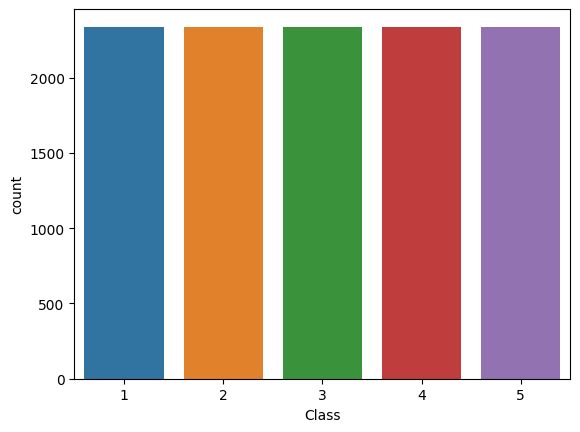

In [ ]:
sm = SMOTE(random_state=0)
X_sm, Y_sm = sm.fit_resample(X,Y)

ax = sns.countplot(x='Class', data=pd.DataFrame(Y_sm, columns=['Class']))

### Entrenamiento de arbol de decisión

In [ ]:
# Dividir datos en entrenamiento (80%) y test (20%)

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

In [ ]:
# Crear el objeto de arbol de decisión utilizando como criterio de pureza de entropía

arbol = DecisionTreeClassifier(criterion='entropy', random_state=0)

In [ ]:
arbol = arbol.fit(X_train,Y_train)
y_pred = arbol.predict(X_test)

### Matriz de confusión

In [ ]:
confusion_matrix(Y_test, y_pred)

array([[ 34,  48,  30,  14,  18],
       [ 47,  77,  44,  29,  39],
       [ 21,  68,  90,  75,  65],
       [ 20,  20,  84, 114, 140],
       [ 16,  26,  70, 127, 245]], dtype=int64)

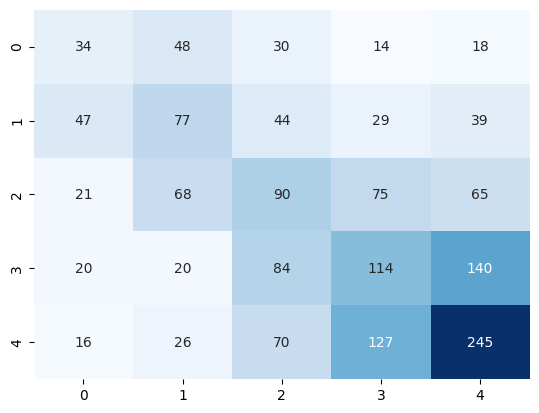

In [ ]:
# Visualizar matriz de confusión
cm = confusion_matrix(Y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.show()

### Reporte de clasificación

In [ ]:
print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           1       0.25      0.24      0.24       144
           2       0.32      0.33      0.32       236
           3       0.28      0.28      0.28       319
           4       0.32      0.30      0.31       378
           5       0.48      0.51      0.49       484

    accuracy                           0.36      1561
   macro avg       0.33      0.33      0.33      1561
weighted avg       0.36      0.36      0.36      1561



### Palabras de mayor importancia

In [ ]:
importancia= arbol.feature_importances_
importancia_atributo = pd.DataFrame(data={"Atributo": X_train.columns,"Importancia": importancia})
importancia_atributo = importancia_atributo.sort_values(by='Importancia', ascending=False).reset_index(drop=True)
importancia_atributo[:20]

,Atributo,Importancia
0,excelente,0.023345
1,malo,0.018399
2,decir,0.014872
3,habitación,0.014370
4,buen,0.013701
5,sucio,0.013167
6,lugar,0.012976
7,comida,0.011984
8,mal,0.010621
9,pésimo,0.010541


### Inicialización y ajuste del modelo

In [ ]:
particiones = KFold(n_splits=10, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'max_depth':[4,6,8,10,20],'min_samples_split':[2, 3, 4, 5]}
arbol = DecisionTreeClassifier(random_state=0)

In [ ]:
mejor_modelo = GridSearchCV(arbol, param_grid, cv=particiones)

# Ajuste del modelo
mejor_modelo.fit(X_train, Y_train)

GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

### Busqueda de parametros de mejor desempeño por medio de GridSearchCV

In [ ]:
GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

GridSearchCV(cv=KFold(n_splits=10, random_state=0, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 6, 8, 10, 20],
                         'min_samples_split': [2, 3, 4, 5]})

In [ ]:
mejor_modelo.best_params_

{'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 4}

In [ ]:
arbol_final = mejor_modelo.best_estimator_

In [ ]:
# Probar modelo

y_pred_train = arbol_final.predict(X_train)
y_pred_test = arbol_final.predict(X_test)

### Evaluación de mejor modelo de clasificación


In [ ]:
confusion_matrix(Y_test, y_pred_test)

array([[ 23,  52,  15,  40,  14],
       [ 39,  69,  34,  74,  20],
       [ 21,  54,  40, 152,  52],
       [ 15,  23,  34, 211,  95],
       [ 12,  23,  15, 221, 213]], dtype=int64)

In [ ]:
print('Exactitud sobre entrenamiento: %.2f' % accuracy_score(Y_train, y_pred_train))
print('Exactitud sobre test: %.2f' % accuracy_score(Y_test, y_pred_test))
#print("Recall: {}".format(recall_score(Y_test,y_pred_test)))
#print("Precisión: {}".format(precision_score(Y_test,y_pred_test)))
#print("Puntuación F1: {}".format(f1_score(Y_test,y_pred_test)))

Exactitud sobre entrenamiento: 0.63
Exactitud sobre test: 0.36


In [ ]:
print(classification_report(Y_test, y_pred_test))

              precision    recall  f1-score   support

           1       0.21      0.16      0.18       144
           2       0.31      0.29      0.30       236
           3       0.29      0.13      0.18       319
           4       0.30      0.56      0.39       378
           5       0.54      0.44      0.49       484

    accuracy                           0.36      1561
   macro avg       0.33      0.32      0.31      1561
weighted avg       0.37      0.36      0.34      1561



## Algoritmo de Random Forest - Santiago Sinisterra

In [181]:
# Dividir datos en entrenamiento (80%) y test (20%)
df = bag_of_words_df_completo
Y = df['Class']
X = df.drop(['Class'], axis=1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

### Entrenamiento y predicción

In [182]:
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
ytest_pred = clasif.predict(X_test)

### Reporte de clasificación

In [183]:
clasif = RandomForestClassifier(random_state=0)
clasif.fit(X_train, Y_train)
predicted = clasif.predict(X_test)

In [184]:
class_report = classification_report(Y_test, predicted)
print(class_report)

              precision    recall  f1-score   support

           1       0.49      0.26      0.34       144
           2       0.42      0.36      0.39       236
           3       0.38      0.28      0.32       319
           4       0.38      0.39      0.39       378
           5       0.55      0.76      0.64       484

    accuracy                           0.46      1561
   macro avg       0.45      0.41      0.41      1561
weighted avg       0.45      0.46      0.45      1561



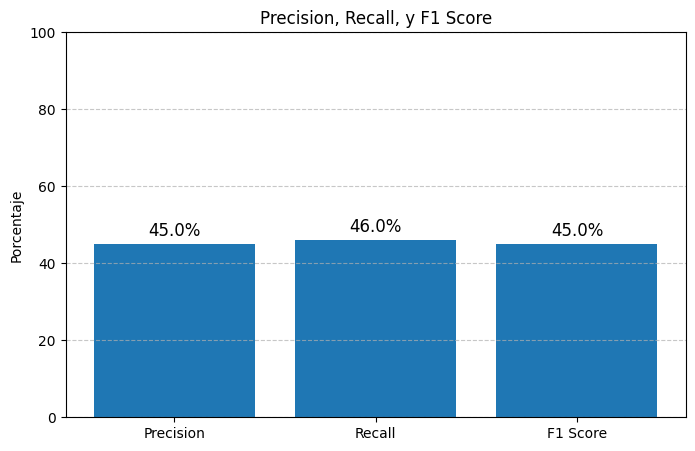

In [188]:
labels = ['Precision', 'Recall', 'F1 Score']
values = [0.45, 0.46, 0.45]

# Calculate percentages
percentages = [value * 100 for value in values]

plt.figure(figsize=(8, 5))
plt.bar(labels, percentages)

for i, value in enumerate(percentages):
    plt.text(i, value + 1, f'{value:.1f}%', ha='center', va='bottom', fontsize=12)

plt.ylim(0, 100)
plt.ylabel('Porcentaje')
plt.title('Precision, Recall, y F1 Score')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

In [189]:
importancia= clasif.feature_importances_
importancia_atributo = pd.DataFrame(data={"Atributo": X_train.columns,"Importancia": importancia})
importancia_atributo = importancia_atributo.sort_values(by='Importancia', ascending=False).reset_index(drop=True)
importancia_atributo[:20]

,Atributo,Importancia
0,excelente,0.009081
1,buen,0.006304
2,hotel,0.005921
3,habitación,0.005566
4,malo,0.005234
5,lugar,0.005144
6,decir,0.004626
7,mal,0.004550
8,comida,0.004489
9,poder,0.004108


In [185]:
confusion_matrix(Y_test, predicted)

array([[ 38,  48,  21,  10,  27],
       [ 27,  84,  55,  37,  33],
       [  9,  48,  88, 102,  72],
       [  3,  12,  44, 147, 172],
       [  0,   6,  22,  88, 368]], dtype=int64)

### Busqueda y aplicación de mejores estimadores

In [ ]:
particiones = KFold(n_splits=5, shuffle=True, random_state = 0)
param_grid = {'criterion':['gini', 'entropy'],'min_samples_split':[2, 4, 6],'max_features':[10, 100, 1000]}

forest = RandomForestClassifier(random_state=0)
modelo = GridSearchCV(forest, param_grid, cv=particiones, refit = True, scoring = 'accuracy')
modelo.fit(X_train, Y_train)

print(modelo.best_params_)

clasif = modelo.best_estimator_
predicted = clasif.predict(X_test)
class_report = classification_report(Y_test, predicted)
print("\nClassification Report")
print(class_report)

{'criterion': 'gini', 'max_features': 100, 'min_samples_split': 4}

Classification Report
              precision    recall  f1-score   support

           1       0.41      0.19      0.26       144
           2       0.40      0.41      0.40       236
           3       0.36      0.24      0.29       319
           4       0.36      0.39      0.38       378
           5       0.56      0.74      0.64       484

    accuracy                           0.45      1561
   macro avg       0.42      0.39      0.39      1561
weighted avg       0.43      0.45      0.43      1561



## Algoritmo logistic regresion - Lina Ojeda




In [124]:
#Separación de los datos en conjunto de test y train
df_filtered_algoritmo_logistic = bag_of_words_df_completo
df_train, df_test = sklearn.model_selection.train_test_split(df_filtered_algoritmo_logistic, test_size=0.2, random_state=0)
X_train = df_train.copy()
y_train = df_train['Class']

X_test = df_test.copy()
y_test = df_test['Class']

X_train.drop(['Class'], axis=1)
X_test.drop(['Class'], axis=1)


,aa,abajo,abandonado,abandonar,abandono,abanico,abarrotado,abasto,aber,abierto,...,él,época,éxito,íbar,íntimo,órden,último,únicamente,único,útil
3055,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
528,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4764,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2141,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0
4617,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2916,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3563,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
678,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
2545,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [108]:
# parameter grid para evaluar el mejor modelo
parameters = {
    'penalty' : ['l2', None],
    'C'       : np.logspace(-10,10,3),
    'solver'  : ['newton-cg', 'lbfgs', 'liblinear'],
}

metrica = RepeatedKFold(n_splits=20, n_repeats= 10, random_state=0)

logreg = LogisticRegression()
modelo = GridSearchCV(logreg, param_grid = parameters, scoring='accuracy', cv=metrica, n_jobs=-1)

In [110]:
modelo.fit(X_train,y_train)
print("Tuned Hyperparameters :", modelo.best_params_) 
print("Accuracy :",modelo.best_score_)
modelo_optimo = modelo.best_estimator_

c:\Users\User\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py:547: FitFailedWarning: 
600 fits failed out of a total of 3600.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
600 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\User\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\User\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\User\AppDat

Tuned Hyperparameters : {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
Accuracy : 0.9969403825673794


In [134]:
prediccion = modelo_optimo.predict(X_test )
score = modelo_optimo.score(X_test, y_test)
print(score)

0.9987187700192185


In [135]:
matriz_confusion = metrics.confusion_matrix(y_test, prediccion)
print(matriz_confusion)

[[144   0   0   0   0]
 [  0 236   0   0   0]
 [  0   1 318   0   0]
 [  0   0   1 377   0]
 [  0   0   0   0 484]]


In [136]:
reporte = classification_report(y_test, prediccion)
print(reporte)

              precision    recall  f1-score   support

           1       1.00      1.00      1.00       144
           2       1.00      1.00      1.00       236
           3       1.00      1.00      1.00       319
           4       1.00      1.00      1.00       378
           5       1.00      1.00      1.00       484

    accuracy                           1.00      1561
   macro avg       1.00      1.00      1.00      1561
weighted avg       1.00      1.00      1.00      1561



## Algoritmo Naive Bayes (Estudiante ... - Ana Sofía Padilla Daza)

Se crean los sets de entrenamiento y test

In [84]:
df = bag_of_words_df_completo
Y = df['Class']
X = df.drop(['Class'], axis=1)

# Crear train y test
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size = 0.3, random_state = 0)

# check the shape of X_train and X_test
X_train.shape, X_test.shape

((5462, 18016), (2342, 18016))

Se escalan los datos

In [85]:
cols = X_train.columns

scaler = RobustScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

X_train = pd.DataFrame(X_train, columns=[cols])
X_test = pd.DataFrame(X_test, columns=[cols])

### Creación del modelo: entrenamiento y predicción

In [86]:
# instantiate the model
modelNB = GaussianNB()

# fit the model
modelNB.fit(X_train, y_train)

GaussianNB()

Se generan las predicciones

In [87]:
# generate prediction
y_pred = modelNB.predict(X_test)
y_pred

array([5, 2, 2, ..., 1, 1, 1], dtype=int64)

Se evalua la predicción

In [88]:
# evaluate accuracy and f1 score
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))
f1 = f1_score(y_pred, y_test, average="weighted")
print("F1 Score:", f1)

print("Number of mislabeled points out of a total %d points : %d" % (X_test.shape[0], (y_test != y_pred).sum()))

Model accuracy score: 0.2511
F1 Score: 0.24681437181093488
Number of mislabeled points out of a total 2342 points : 1754


In [89]:
# Compare train and test
y_pred_train = modelNB.predict(X_train)
y_pred_train

print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))

Training-set accuracy score: 0.8103


Matriz de confusión

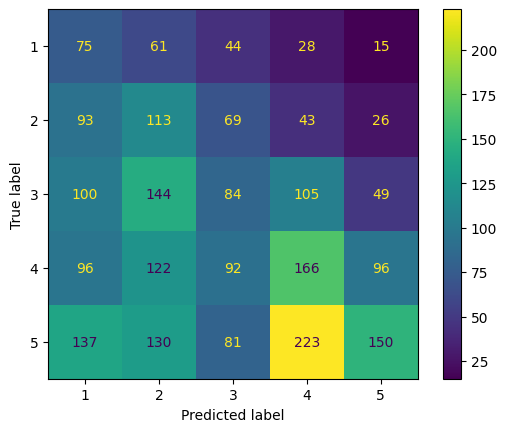

In [90]:
# matriz
labels = [1,2,3,4,5]
cm = confusion_matrix(y_test, y_pred, labels=labels)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
disp.plot();

Resporte de **clasificación**

In [91]:
print(classification_report(y_test, y_pred))

TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

# print classification accuracy
classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)
print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))

# print classification error
classification_error = (FP + FN) / float(TP + TN + FP + FN)
print('Classification error : {0:0.4f}'.format(classification_error))

# print precision score
precision = TP / float(TP + FP)
print('Precision : {0:0.4f}'.format(precision))

# print recall
recall = TP / float(TP + FN)
print('Recall or Sensitivity : {0:0.4f}'.format(recall))

# print specificity
specificity = TN / (TN + FP)
print('Specificity : {0:0.4f}'.format(specificity))

              precision    recall  f1-score   support

           1       0.15      0.34      0.21       223
           2       0.20      0.33      0.25       344
           3       0.23      0.17      0.20       482
           4       0.29      0.29      0.29       572
           5       0.45      0.21      0.28       721

    accuracy                           0.25      2342
   macro avg       0.26      0.27      0.25      2342
weighted avg       0.30      0.25      0.26      2342

Classification accuracy : 0.5497
Classification error : 0.4503
Precision : 0.5515
Recall or Sensitivity : 0.4464
Specificity : 0.6494


# Generacion de prediccion con mejor algoritmo

In [191]:
dataPrueba = pd.read_csv('prueba.csv')
dataPrueba['Class'] = float('nan')
dataPrueba.sample(5)

,Review,Class
169,"Buena comida, pero la razón por la que vienen ...",NaN
339,"Muy buena comida, muy buena musica, servicio m...",NaN
1472,"Fuimos en domingo por la mañana, así que si ti...",NaN
1259,"Se debe conocer caminando, de día y otra cosa ...",NaN
73,"Fuimos por las opiniones que leímos, que eran ...",NaN


In [192]:
dataPruebaTokenizada = dataPrueba.copy()
nlp = spacy.load("es_core_news_sm")
for i in range(len(dataPruebaTokenizada["Review"])):
    
    texto = dataPruebaTokenizada["Review"].iloc[i]
    
    #Eliminacion signos de puntuacion
    texto = texto.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))

    #Tokenizacion
    palabras = nltk.word_tokenize(texto)
    lemas = []
            
    for palabra in palabras:
      # Convertir a minusculas
      palabra = palabra.lower()
      if (palabra.strip()): 
      # Revisar numeros y 
        puras.append(palabra)
        lemas.append(palabra)

    dataPruebaTokenizada["Review"].iloc[i] = lemas

C:\Users\User\AppData\Local\Temp\ipykernel_11448\2341423428.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataPruebaTokenizada["Review"].iloc[i] = lemas
C:\Users\User\AppData\Local\Temp\ipykernel_11448\2341423428.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataPruebaTokenizada["Review"].iloc[i] = lemas
C:\Users\User\AppData\Local\Temp\ipykernel_11448\2341423428.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataPr

In [193]:
vectorizado = dataPruebaTokenizada["Review"].map(str)
count = CountVectorizer()
bag_of_words = count.fit_transform(vectorizado)
bag_of_words_array = bag_of_words.toarray()
bag_of_words_df = pd.DataFrame(bag_of_words_array, columns=count.get_feature_names_out())
bag_of_words_df["Class"] = float('nan')
bag_of_words_df.sample(5)

result_df = pd.DataFrame(columns=bag_of_words_df_completo.columns)

columnasBag=count.get_feature_names_out()

for col in bag_of_words_df_completo.columns:
    if col in count.get_feature_names_out():
        result_df[col] = bag_of_words_df[col]
    else:
        result_df[col] = 0  # Fill with 0 for empty columns

# Fill in the remaining columns (not in selected_columns) with 0
for col in result_df.columns:
    if col not in bag_of_words_df_completo.columns:
        result_df[col] = 0

result_df = result_df.fillna(int(0))

In [194]:
result_df.head()

,aa,abajo,abandonado,abandonar,abandono,abanico,abarrotado,abasto,aber,abierto,...,época,éxito,íbar,íntimo,órden,último,únicamente,único,útil,Class
0,0.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [195]:
Y = result_df['Class']
X = result_df.drop(['Class'], axis=1)
X.shape

(1750, 5297)

In [196]:
prediccion = clasif.predict(X)
dataPrueba['Class'] = prediccion
dataPrueba.sample(5)

,Review,Class
1609,Un hotel que tiene 10 pisos y no le funciona e...,4
457,El hotel Nacional fue la primera parada de nue...,4
1037,"A destacar el buen aseo, la comodidad de las c...",3
358,Un restaurante con una combinación a la vez el...,5
910,Es fácil coger un taxi desde el hotel Maya. Tu...,5


In [197]:
average_A = dataPrueba['Class'].mean()
print(average_A)

4.042285714285715


In [180]:
dataPrueba.to_csv('datosConClasificacion.csv')